In [1]:
library(ggplot2)
library(dplyr)
library(Matrix)
library(data.table)
library(stringr)
library(patchwork)
library(glue)
library(ggforce)
library(vcfR)
library(purrr)
library(magrittr)
library(parallel)
library(ggpubr)
library(tidygraph)
library(extraDistr)
library(IRdisplay)
library(igraph)
library(ggridges)
library(ggtree)
library(numbat)
options(repr.matrix.max.cols=30, repr.matrix.max.rows=20)
options(repr.vector.max.items = 50)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union



Attaching package: ‘data.table’


The following objects are masked from ‘package:dplyr’:

    between, first, last



   *****       ***   vcfR   ***       *****
   This is vcfR 1.12.0 
     browseVignettes('vcfR') # Documentation
     citation('vcfR') # Citation
   *****       *****      *****       *****



Attaching package: ‘purrr’


The following object is masked from ‘package:data.table’:

    transpose



Attaching package: ‘magrittr’


The following object is masked from ‘package:purrr’:

    set_names



Attaching package: ‘tidygraph’


The following object is masked from ‘package:stats’:

    filter



Attaching package: ‘extraDistr’


The following object is masked from ‘package:purrr’:

    rdunif



Attaching package: ‘igraph’


The following object is masked from ‘package:t

In [48]:
cell_annot = fread('~/paper_data/cell_annotations/cell_annot_WASHU_march.tsv') %>%
    split(.$sample)

con = readRDS('~/paper_data/conos_objects/conos_WASHU.rds')

In [98]:
for (sample in names(cell_annot)) {
    cells_count = rownames(con$samples[[sample]]$counts)
    cell_annot[[sample]] = cell_annot[[sample]] %>% filter(cell %in% cells_count)
}

In [241]:
for (sample in 'DCIS1') {
    saveRDS(t(con_bc$samples[[sample]]$misc$rawCounts), glue('~/paper_data/processed/{sample}_counts.rds'))
}

# Collage

In [194]:
bind_rows(cell_annot) %>% count(cell_type)

cell_type,n
<chr>,<int>
B,3686
CD14+Mono,16183
CD16+Mono,4249
CD4+T,18247
CD8+T,8334
DC,735
NK,6282
Plasma,17165


In [187]:
samples = c('58408_SMM', '58408_Primary', 
            '47491_SMM', '47491_Primary',
            '27522_Primary', '27522_Relapse_2',
            '27522_Remission', '27522_Relapse_1',
            '37692_Primary', '59114_Relapse_1')

cell_annot[samples] %>% lapply(nrow) %>% rbind

,58408_SMM,58408_Primary,47491_SMM,47491_Primary,27522_Primary,27522_Relapse_2,27522_Remission,27522_Relapse_1,37692_Primary,59114_Relapse_1
,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
.,2374,3880,1709,1465,4220,3499,727,2275,3078,3413


In [193]:
26640

[1] 26640

In [166]:
df = list()

mda_samples = c(paste0('ATC', 1:5), paste0('TNBC', 1:5), c('DCIS1'))

samples_all = c(samples, mda_samples, 'NCI-N87')

for (sample in samples_all) {
    message(sample)
    df[[sample]] = fread(glue('~/paper_data/processed/{sample}_allele_counts.tsv.gz'), nThread = 4)
}

58408_SMM

58408_Primary

47491_SMM

47491_Primary

27522_Primary

27522_Relapse_2

37692_Primary

59114_Relapse_1

ATC1

ATC2

ATC3

ATC4

ATC5

TNBC1

TNBC2

TNBC3

TNBC4

TNBC5

DCIS1

NCI-N87



## Coverage metrics

In [170]:
SNPs = lapply(
        samples_all,
        function(sample) {
            df[[sample]] %>% 
            filter(GT %in% c('0|1', '1|0')) %>%
            filter(CHROM %in% 1:22) %>%
            distinct(CHROM, POS, REF, ALT, snp_id, GT, DP_all) %>%
            rename(DP = DP_all) %>%
            mutate(sample = sample)
        }
    ) %>% bind_rows()

In [161]:
chrom_sizes = fread('~/ref/hg38.chrom.sizes.txt') %>% 
    setNames(c('CHROM', 'chr_size')) %>%
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22) %>%
    mutate(CHROM = factor(CHROM, 1:22)) %>%
    arrange(CHROM)

genome_size = sum(chrom_sizes$chr_size)

In [175]:
SNPs %>% 
    mutate(sample = str_replace_all(sample, '_', '-')) %>%
    count(sample) %>%
    arrange(n) %>%
    mutate(sample = factor(sample, unique(sample))) %>%
    mutate(snp_density = signif(n/genome_size, 2) * 1e6) %>%
    pull(snp_density) %>%
    range

[1] 16 68

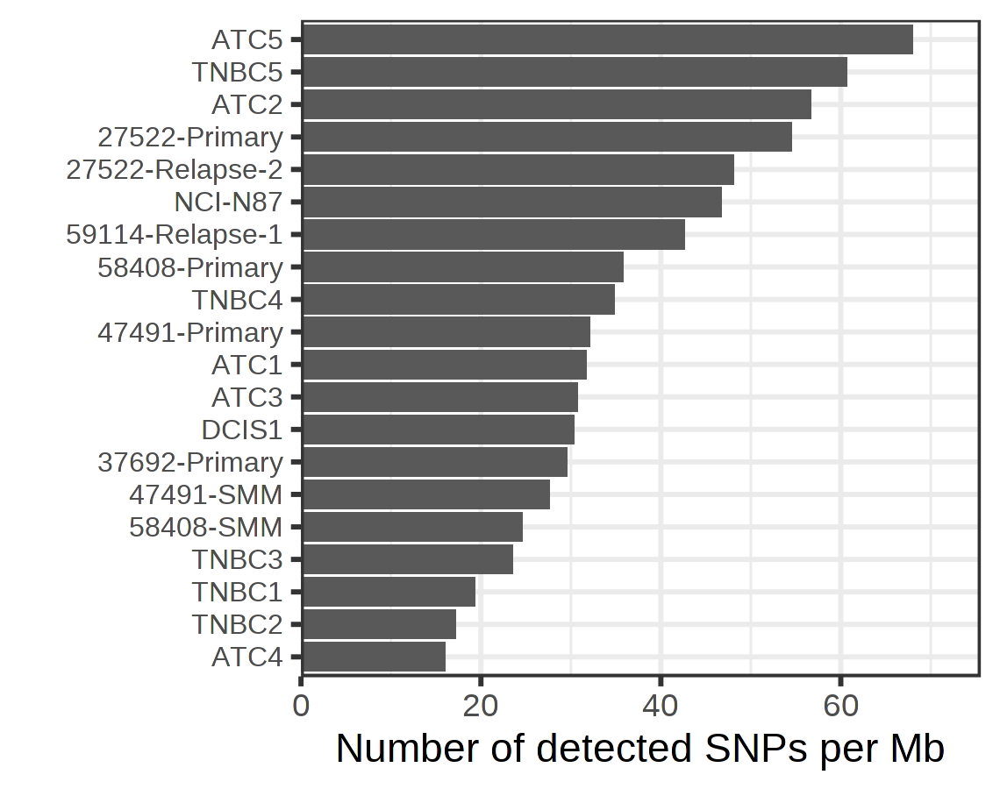

In [171]:
p = SNPs %>% 
    mutate(sample = str_replace_all(sample, '_', '-')) %>%
    count(sample) %>%
    arrange(n) %>%
    mutate(sample = factor(sample, unique(sample))) %>%
    mutate(snp_density = n/genome_size) %>%
    ggplot(
        aes(x = sample, y = snp_density * 1e6)
    ) +
    geom_col() +
    coord_flip() +
    theme_bw() +
    scale_y_continuous(expand = expansion(c(0,0.11))) +
    theme(axis.text.y = element_text(size = 7.5)) +
    ylab('Number of detected SNPs per Mb') +
    xlab('')

do_plot(p, 'snp_density', w = 3.8, h = 3)

In [57]:
cell_snps = lapply(
        samples_all,
        function(sample) {
            df[[sample]] %>% 
                filter(GT %in% c('0|1', '1|0')) %>%
                group_by(cell) %>%
                summarise(DP = sum(DP)) %>%
                mutate(sample = sample)
        }
    ) %>% bind_rows()

In [3]:
cell_snps = fread('~/paper_data/cell_snp_coverages.tsv', sep = '\t')

In [180]:
cell_snps %>% 
    mutate(sample = str_replace_all(sample, '_', '-')) %>%
    group_by(sample) %>%
    summarise(
        DP_median = median(DP),
        n = n()
    ) %>%
    pull(DP_median) %>%
    range

[1]  159 1045

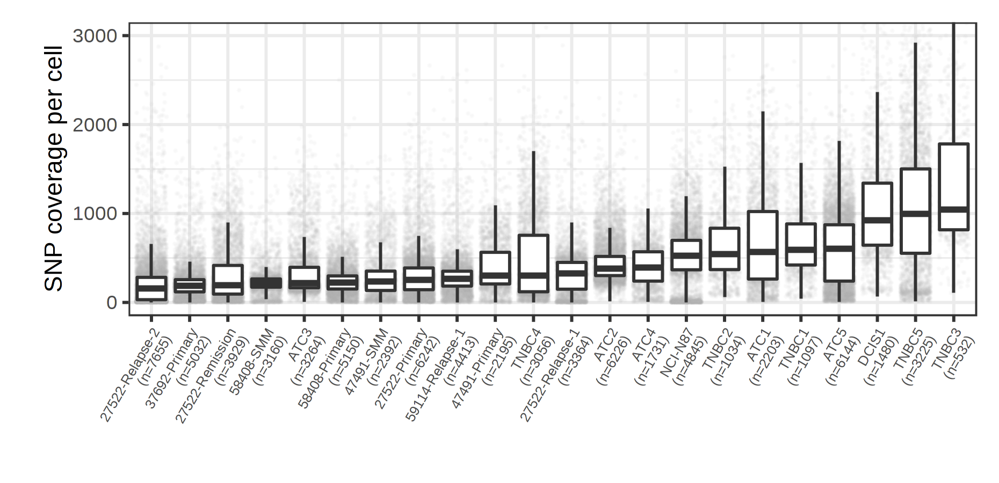

In [158]:
options(repr.plot.width = 6.2, repr.plot.height = 3, repr.plot.res = 300)

p = cell_snps %>% 
    mutate(sample = str_replace_all(sample, '_', '-')) %>%
    group_by(sample) %>%
    mutate(
        DP_median = median(DP),
        n = n()
    ) %>%
    ungroup() %>%
    arrange(DP_median) %>%
    mutate(sample = paste0(sample, '\n(n=', n, ')')) %>%
    mutate(sample = factor(sample, unique(sample))) %>%
    ggplot(
        aes(x = sample, y = DP)
    ) +
    theme_bw() +
    geom_jitter(alpha = 0.05, size = 0.1, color = 'gray') +
    geom_boxplot(outlier.alpha = 0) +
    coord_cartesian(ylim = c(0,3000)) +
    theme(
        axis.text.x = element_text(angle = 60, hjust = 1, size = 6, vjust = 1),
        plot.margin = margin(10,10,10,20)
    ) +
    ylab('SNP coverage per cell') +
    xlab('')

p = ggrastr::rasterize(p, layers = 'Point', dpi = 300)

do_plot(p, 'coverage_cell', 6.2, 3)

In [113]:
gtf = fread('~/ref/hg38.refGene.gtf')
cols = c('CHROM', 'source', 'biotype', 'start', 'end', 'a', 'strand', 'b', 'info')
colnames(gtf) = cols

gtf = gtf %>% 
    mutate(CHROM = str_remove(CHROM, 'chr')) %>%
    filter(CHROM %in% 1:22)

In [164]:
snps_ranges = SNPs %>% 
    {GenomicRanges::GRanges(
        seqnames = .$CHROM,
        IRanges::IRanges(start = .$POS,
            end = .$POS)
    )}

UTR_regions = gtf %>% 
    filter(biotype %in% c('3UTR', '5UTR')) %>%
    {GenomicRanges::GRanges(
        seqnames = .$CHROM,
        IRanges::IRanges(start = .$start,
            end = .$end)
    )}

exon_regions = gtf %>% 
    filter(biotype == 'exon') %>%
    {GenomicRanges::GRanges(
        seqnames = .$CHROM,
        IRanges::IRanges(start = .$start,
            end = .$end)
    )}

transcript_regions = gtf %>% 
    filter(biotype == 'transcript') %>%
     {GenomicRanges::GRanges(
        seqnames = .$CHROM,
        IRanges::IRanges(start = .$start,
            end = .$end)
    )}

overlap_exon = GenomicRanges::findOverlaps(snps_ranges, exon_regions)

overlap_UTR = GenomicRanges::findOverlaps(snps_ranges, UTR_ranges)

overlap_transcript = GenomicRanges::findOverlaps(snps_ranges, transcript_regions)

SNPs = SNPs %>% 
    mutate(
        gene_region = case_when(
            row_number() %in% as.data.frame(overlap_UTR)[,1] ~ 'UTR',
            row_number() %in% as.data.frame(overlap_exon)[,1] ~ 'Exonic',
            row_number() %in% as.data.frame(overlap_transcript)[,1] ~ 'Intronic',
            T ~ 'Other'
        )
    ) %>%
    mutate(gene_region = factor(gene_region, c('UTR', 'Exonic', 'Intronic', 'Other')))

In [21]:
SNPs = fread('~/paper_data/snp_regions.tsv', sep = '\t')

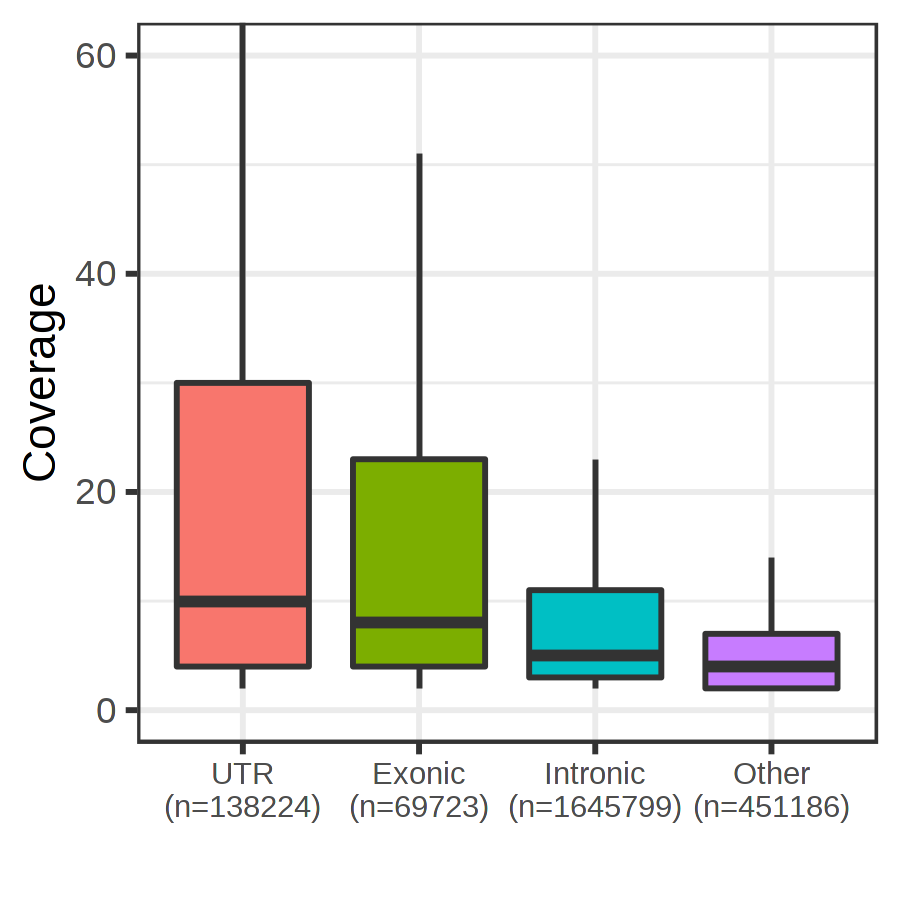

In [46]:
p = SNPs %>% 
    mutate(gene_region = factor(gene_region, c('UTR', 'Exonic', 'Intronic', 'Other'))) %>%
    arrange(gene_region) %>%
    group_by(gene_region) %>%
    mutate(n = n()) %>%
    ungroup() %>%
    mutate(gene_region = glue('{gene_region}\n(n={n})')) %>%
    mutate(gene_region = factor(gene_region, unique(gene_region))) %>%
    ggplot(
        aes(x = gene_region, y = DP, fill = gene_region)
    ) +
    geom_boxplot(outlier.alpha = 0) +
    coord_cartesian(ylim = c(0, 60)) +
    theme_bw() +
    theme(axis.text.x = element_text(size = 7.25)) +
    xlab('') +
    guides(fill = 'none') +
    ylab('Coverage')

do_plot(p, 'snp_distr_cov.pdf', w = 3, h = 3)

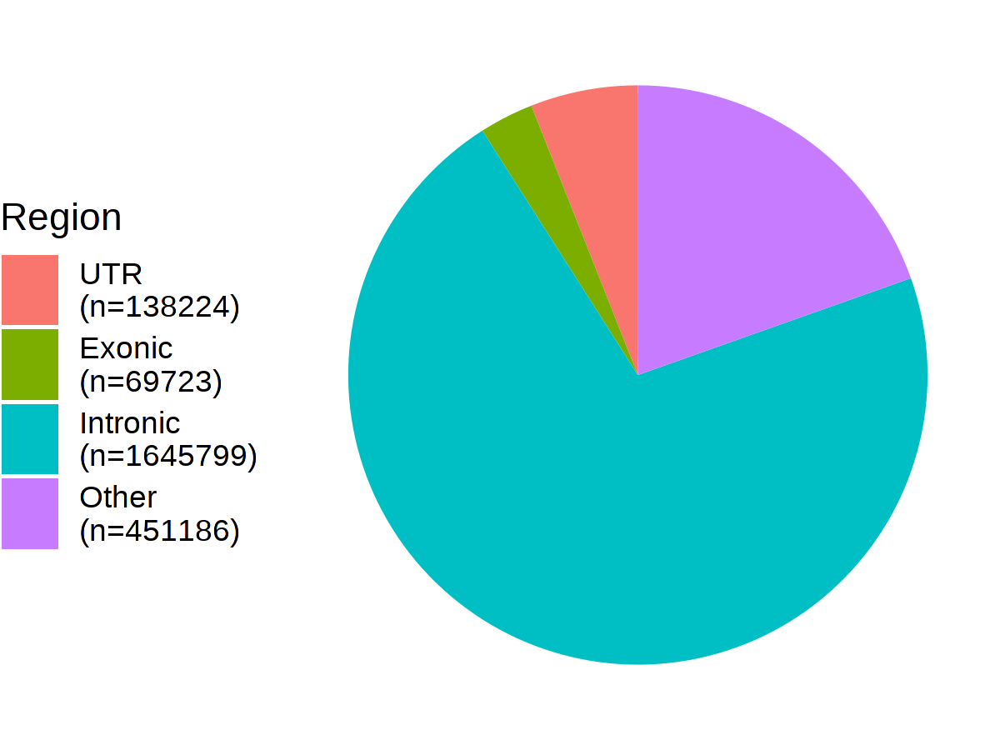

In [40]:
p = SNPs %>%
    mutate(gene_region = factor(gene_region, c('UTR', 'Exonic', 'Intronic', 'Other'))) %>%
    count(gene_region) %>%
    arrange(gene_region) %>%
    mutate(prop = n/sum(n)) %>%
    mutate(gene_region = glue('{gene_region}\n(n={n})')) %>%
    mutate(gene_region = factor(gene_region, unique(gene_region))) %>%
    ggplot(
        aes(x = prop, y = '', fill = gene_region, label = signif(prop, 2) * 100)
    ) +
    geom_col() +
    coord_polar("x", start=0) +
    ylab('') +
    theme_void() +
    guides(fill = guide_legend(title = 'Region')) +
    theme(legend.position = 'left', legend.text = element_text(margin = margin(t = 2, b = 2)))

do_plot(p, 'snp_distr.pdf', w = 4, h = 3)

In [ ]:
gtf = fread('../hg38.refGene.gtf')
cols = c('CHROM', 'source', 'biotype', 'start', 'end', 'a', 'strand', 'b', 'info')
colnames(gtf) = cols

gtf = gtf %>% filter(CHROM %in% paste0('chr', 1:22))

In [182]:
clone_post = list()

copykat.out = list()

samples = c('58408_SMM', '58408_Primary', 
            '47491_SMM', '47491_Primary',
            '27522_Primary', '27522_Relapse_2',
            '37692_Primary', '59114_Relapse_1'
           )

for (sample in samples) {
    
    i = 2
        
    clone_post[[sample]] = fread(glue('~/paper_data/numbat_out/{sample}_test/clone_post_{i}.tsv')) %>%
        mutate(sample = sample)
    
    # copykat results
    copykat.out[[sample]] = fread(glue('~/paper_data/copykat_out/{sample}/{sample}_copykat_prediction.txt')) %>%
        rename(cell = cell.names) %>%
        mutate(copykat.pred = ifelse(copykat.pred == 'diploid', 'N', 'T')) %>%
        mutate(sample = sample)
    
}

method,recall,precision,accuracy
<fct>,<dbl>,<dbl>,<dbl>
Numbat,0.933,0.981,0.987
Numbat-exp,0.931,0.980,0.986
CopyKAT,0.779,0.615,0.747


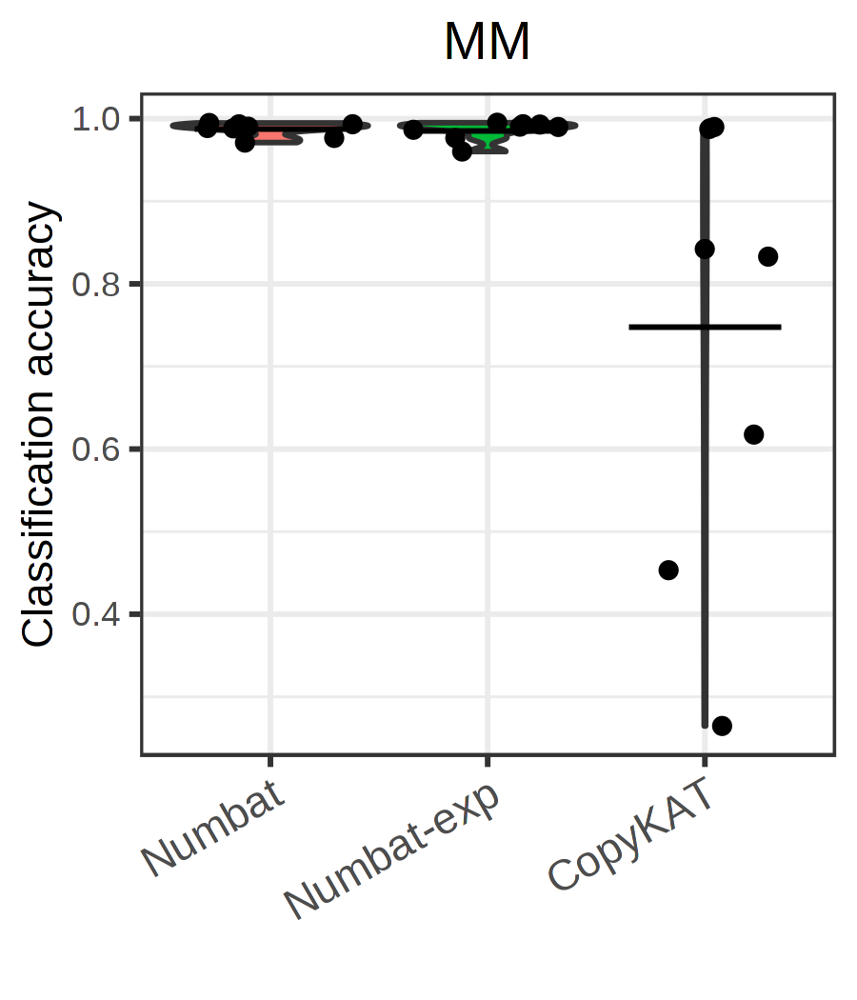

In [183]:
options(repr.plot.width = 3, repr.plot.height = 3.5, repr.plot.res = 300)

D = bind_rows(clone_post) %>%
    inner_join(bind_rows(cell_annot), by = c('cell', 'sample')) %>%
    inner_join(bind_rows(copykat.out), by = c('cell', 'sample')) %>%
    mutate(
        p_cnv = ifelse(is.na(p_cnv), 1 - p_1, p_cnv),
        numbat.pred = ifelse(p_cnv > 0.5, 'T', 'N'),
        numbat.exp.pred = ifelse(p_cnv_x > 0.5, 'T', 'N')
    ) %>%
    select(copykat.pred, numbat.pred, numbat.exp.pred, annot, sample) %>%
    melt(measure.vars = c('numbat.pred', 'copykat.pred', 'numbat.exp.pred'),
         variable.name = 'method',
         value.name = 'pred') %>%
    mutate(method = c(
        'numbat.pred' = 'Numbat', 'numbat.exp.pred' = 'Numbat-exp', 
        'copykat.pred' = 'CopyKAT')[as.character(method)]
    ) %>%
    mutate(method = factor(method, c('Numbat', 'Numbat-exp', 'CopyKAT'))) %>%
    group_by(sample, method) %>%
    summarise(
        recall = mean(pred[annot == "T"] == "T"),
        precision = mean(annot[pred == "T"] == "T"),
        accuracy = mean(pred == annot),
        .groups = 'drop'
    )

set.seed(0)

p = ggplot(
        D,
        aes(x = method, y = accuracy, fill = method)
    ) +
    geom_violin(
#         draw_quantiles = c(0.5)
    ) +
    stat_summary(fun=mean, geom="crossbar", size = 0.2, width = 0.7) +
    geom_jitter() +
    theme_bw() +
    ylab('Classification accuracy') +
    xlab('') +
    ggtitle('MM') +
    theme(
        plot.title = element_text(hjust = 0.5),
        legend.position = 'none',
        axis.text.x = element_text(size = 11, angle = 30, hjust = 1)
    )

do_plot(p, glue('MM_tvn_scatter'), 3, 3.5)

D %>%
group_by(method) %>%
summarise_at(
    c('recall', 'precision', 'accuracy'),
    function(x){signif(mean(x),3)}
) %>%
display

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will rep

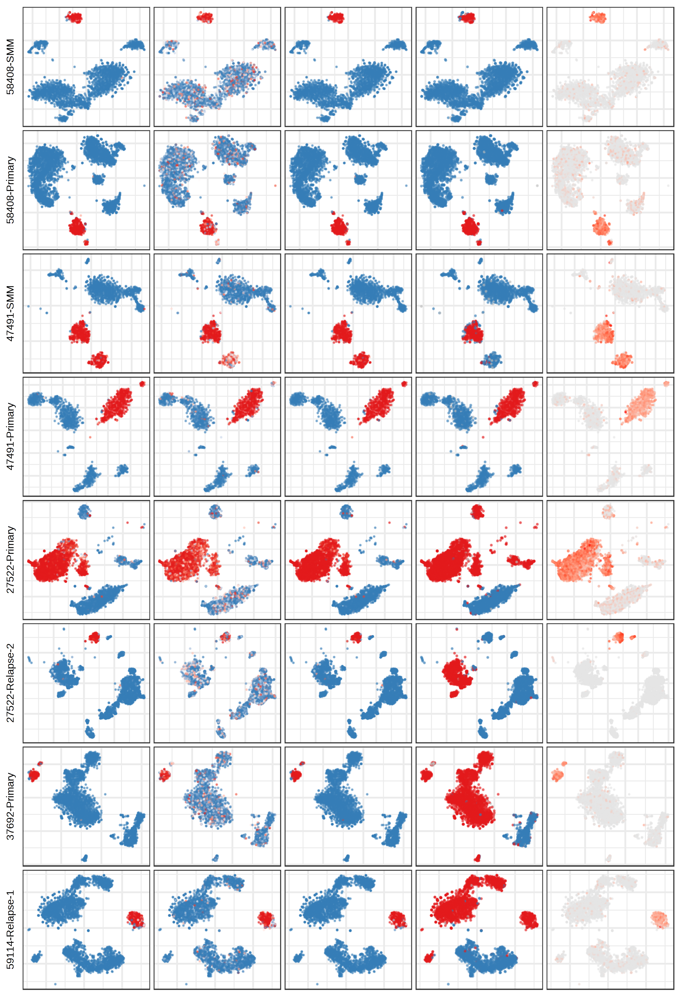

In [122]:
options(repr.plot.width = 7.5, repr.plot.height = 11, repr.plot.res = 300)

copykat_plots = list()
joint_plots = list()
exp_plots = list()
allele_plots = list()
marker_plots = list()

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')
colormap = leaflet::colorNumeric(c(pal[2], pal[1]), domain = c(0,1))
cap = 5

options(warn = -1)

for (sample in samples) {
    
    clone_post = fread(glue('~/paper_data/numbat_out/{sample}_test/clone_post_2.tsv'))
    
    cell_clusters = con$samples[[sample]]$clusters$PCA$multilevel
    cell_clusters = cell_clusters[names(cell_clusters) %in% cell_annot[[sample]]$cell]

    marker_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        plot.na = F,
        groups = cell_clusters,
        plot.theme = theme_bw(),
        gene = 'MZB1',
        raster = T,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
    joint_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
        raster = T,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)

    exp_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_x, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
        raster = T,
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0),
        axis.title.y = element_text(size = 8)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish) +
    ylab(str_replace_all(sample, '_', '-'))
    
   allele_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.1, 
        colors = cell_annot[[sample]] %>% 
            left_join(clone_post, by = 'cell') %>%
            {setNames(.$p_cnv_y, .$cell)},
        show.legend = F,
        mark.groups = T,
        plot.na = F,
        plot.theme = theme_bw(),
       raster = T
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    ) +
    scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)
    
    copykat_plots[[sample]] = con$samples[[sample]]$plotEmbedding(
        alpha=0.5,
        size=0.2, 
        groups = cell_annot[[sample]] %>%
            left_join(
                copykat.out[[sample]],
                by = 'cell'
            ) %>%
            mutate(copykat.pred = ifelse(is.na(copykat.pred), 'Unknown', copykat.pred)) %>%
            {setNames(.$copykat.pred, .$cell)},
        show.legend = F,
        mark.groups = F,
        plot.na = F,
        plot.theme = theme_bw(),
        raster = T,
        pal = c('N' = pal[2], 'T' = pal[1], 'Unknown' = 'gray')
    ) +
    theme(
        plot.title = element_text(size = 8),
        plot.margin = margin(0,0,0,0)
    )
    
}

options(warn = 0)

panel = wrap_plots(c(rbind(exp_plots, allele_plots, joint_plots, copykat_plots, marker_plots)), ncol = 5, byrow = T)

do_plot(panel, 'MM_tvn', 7.5, 11)

## Phylogenies

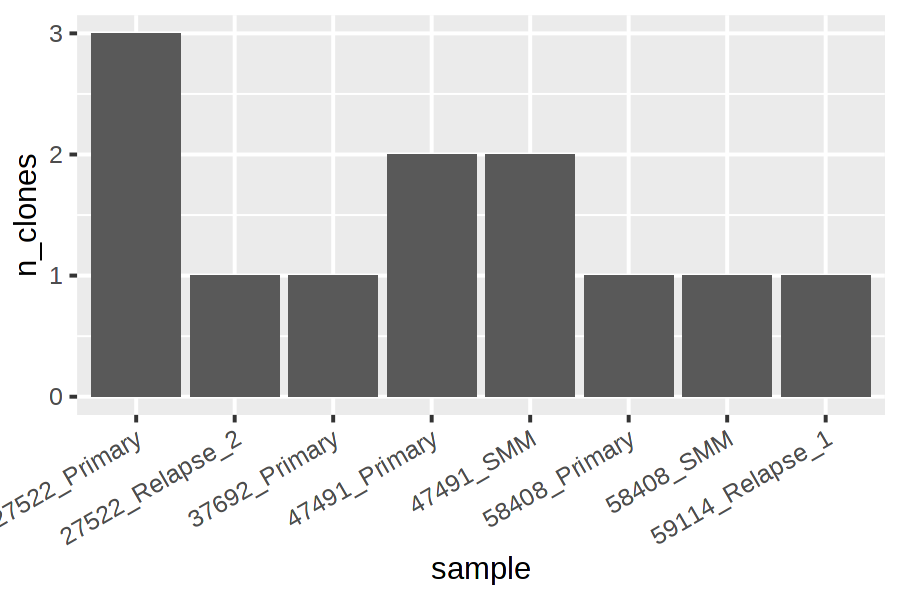

In [91]:
options(repr.plot.width = 4.5, repr.plot.height = 3, repr.plot.res = 200)

lapply(samples, function(sample) {
    out_dir = glue('~/paper_data/numbat_out/{sample}_test')
    fread(glue('{out_dir}/clone_post_2.tsv')) %>%
    filter(compartment_opt == 'tumor') %>%
    summarise(
        n_clones = length(unique(clone_opt))
    ) %>%
    mutate(sample = UQ(sample))
}) %>%
bind_rows() %>%
arrange(sample) %>%
ggplot(
    aes(x = sample, y = n_clones)
) +
geom_col() +
theme(axis.text.x = element_text(angle = 30, hjust = 1, vjust = 1))

In [83]:
nb = list()
for (sample in samples) {
    message(sample)
    out_dir = glue('~/paper_data/numbat_out/{sample}_test')
    nb[[sample]] = Numbat$new(out_dir, i = 2)
}

58408_SMM

58408_Primary

47491_SMM

47491_Primary

27522_Primary

27522_Relapse_2

37692_Primary

59114_Relapse_1



In [94]:
nb[['27522_Primary']]$clone_post %>% count(GT_opt, compartment_opt)

GT_opt,compartment_opt,n
<chr>,<chr>,<int>
,normal,2003
,tumor,8
"13a,22a",tumor,795
"13a,22a,1c",tumor,1414


In [85]:
R.utils::sourceDirectory('~/Numbat/R')

plots = list()

for (sample in samples) {

    plots[[sample]] = nb[[sample]]$plot_phylo_heatmap(
        annot = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)}
    ) +
    ggtitle(sample)
    
}

Warning message:
“The `x` argument of `as_tibble.matrix()` must have unique column names if `.name_repair` is omitted as of tibble 2.0.0.
Using compatibility `.name_repair`.
This warning is displayed once every 8 hours.
Call `lifecycle::last_lifecycle_warnings()` to see where this warning was generated.”


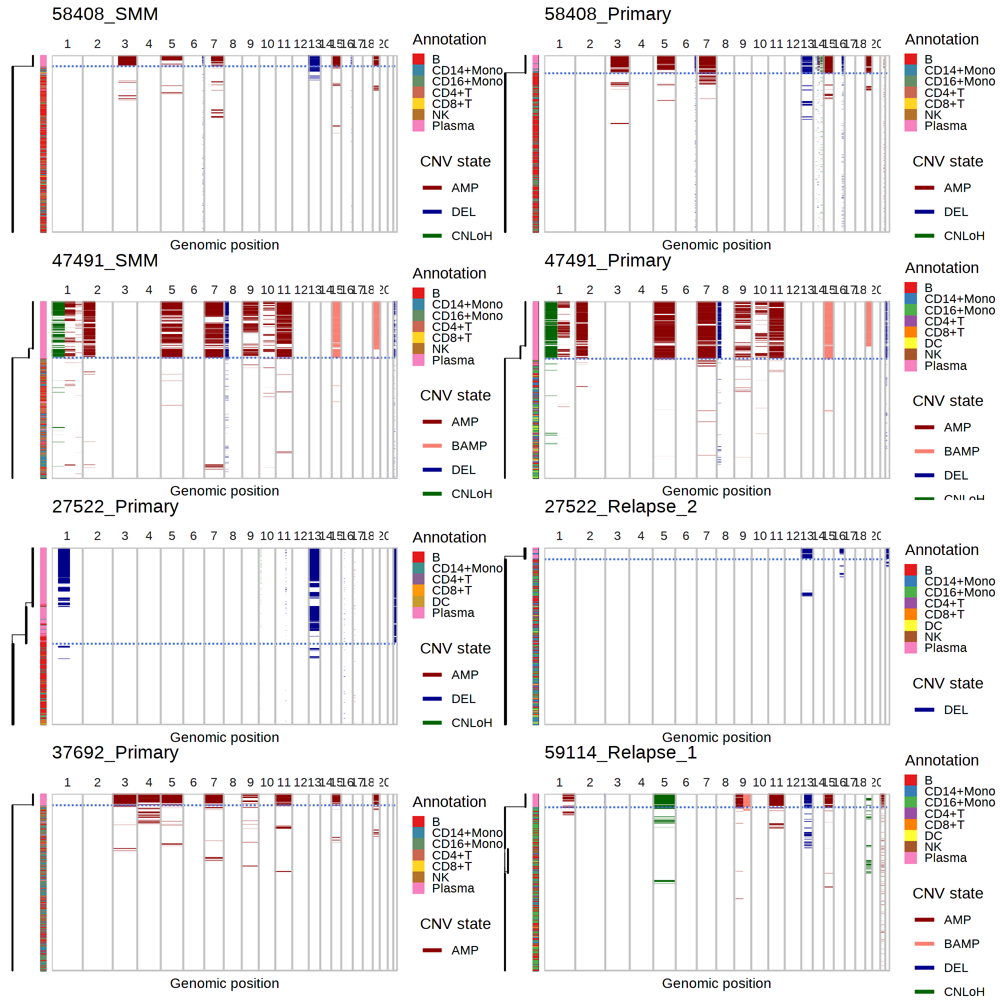

In [87]:
options(repr.plot.width = 10, repr.plot.height = 10, repr.plot.res = 200)

wrap_plots(plots, ncol = 2, guides = 'collect')

# 57075

## Relapse

In [5]:
res = list()

In [6]:
sample = '57075_Relapse_1'

res[[sample]] = fetch_results(glue('~/results/WASHU/{sample}'), i = 2)

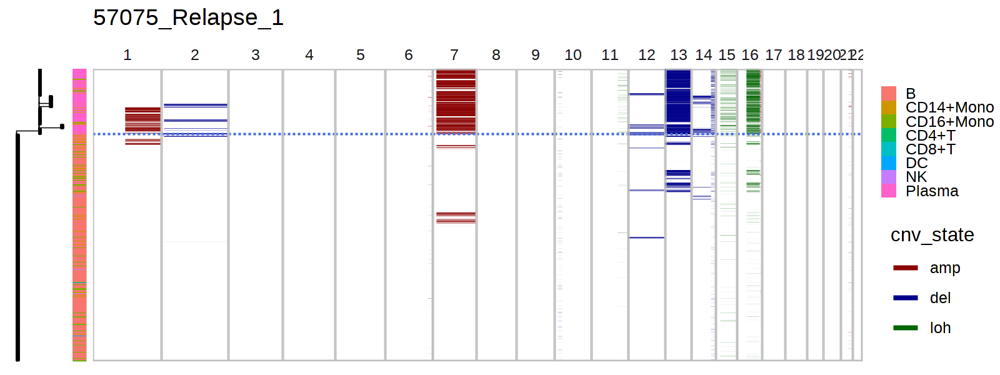

In [8]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    size = 0.05,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    logBF_min = 2,
    logBF_max = 5
) +
ggtitle(sample)

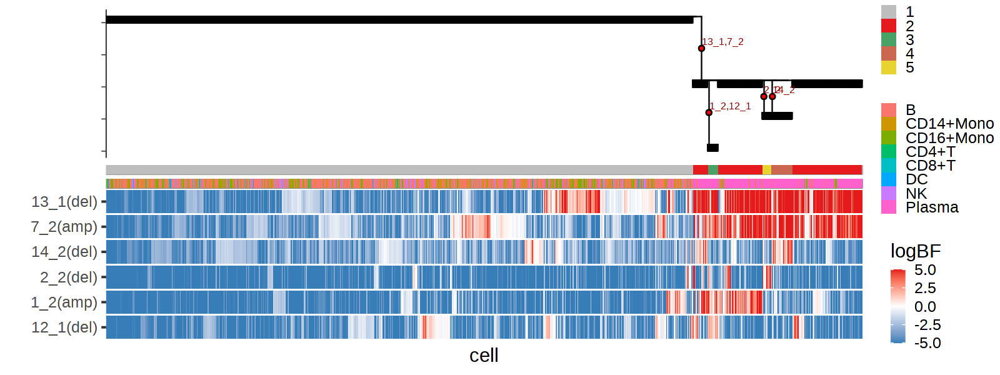

In [2494]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

tree_heatmap(
    res[[sample]]$joint_post %>% filter(seg %in% colnames(res[[sample]]$geno)),
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 0.1,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tvn = FALSE
) +
theme(plot.title = element_text(size = 8))

Warning message:
“Removed 159133 rows containing missing values (geom_point).”
Warning message:
“Removed 131945 rows containing missing values (geom_point).”
Warning message:
“Removed 67459 rows containing missing values (geom_point).”
Warning message:
“Removed 74080 rows containing missing values (geom_point).”
Warning message:
“Removed 34045 rows containing missing values (geom_point).”


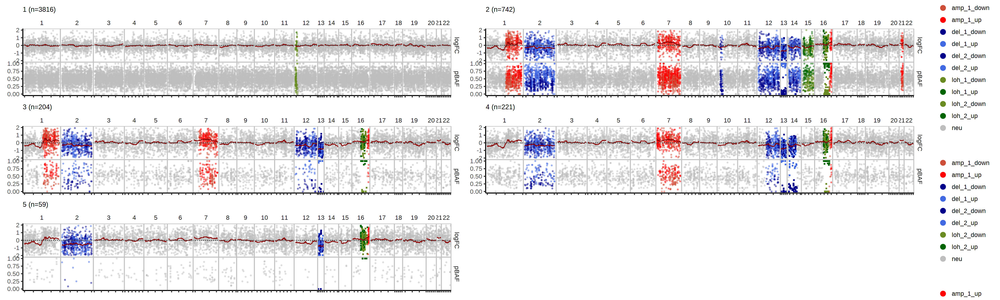

In [2483]:
options(repr.plot.width = 20, repr.plot.height = 6, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

res[[sample]]$bulk_clones %>% plot_bulks(ncol = 2)

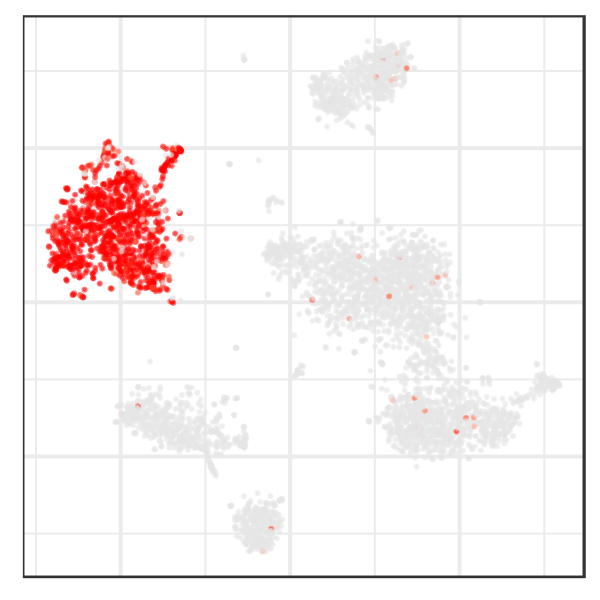

In [2504]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        {setNames(pmax(.$p_cnv, 0.9), .$cell)},
    mark.groups = F,
    plot.theme = theme_bw()
)

# 58408

## SMM

In [9]:
sample = '58408_SMM'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

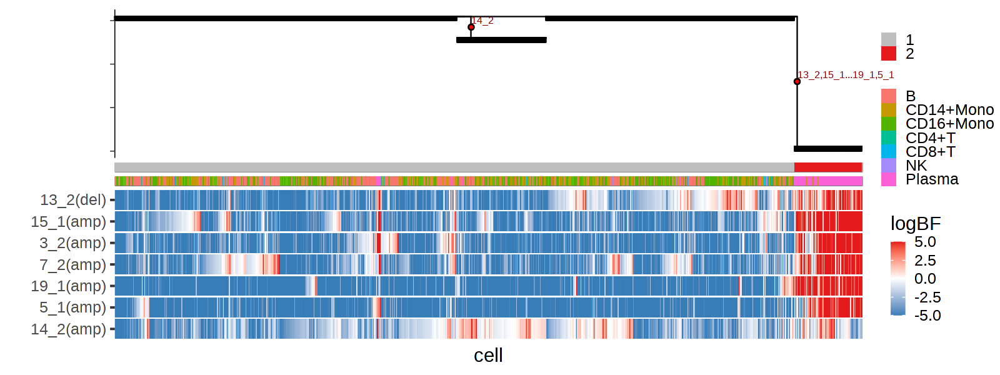

In [2095]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

tree_heatmap(
    res[[sample]]$joint_post %>% filter(seg %in% colnames(res[[sample]]$geno)),
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 0.1,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tvn = FALSE
) +
theme(plot.title = element_text(size = 8))

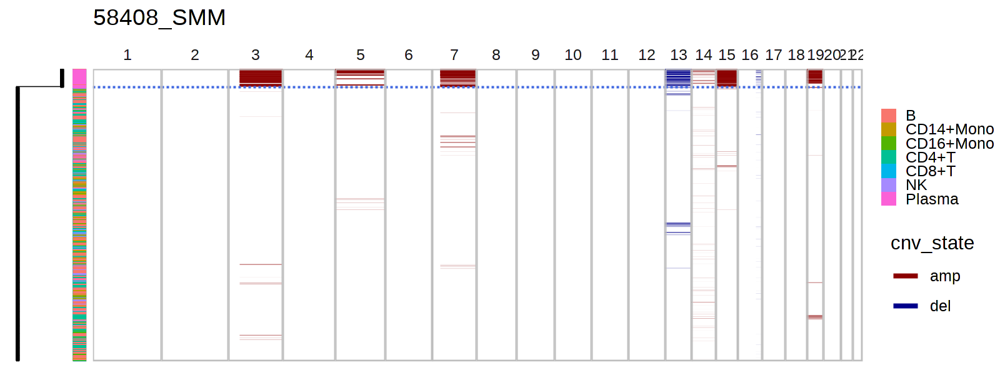

In [10]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.3,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 10
) +
ggtitle(sample)

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.



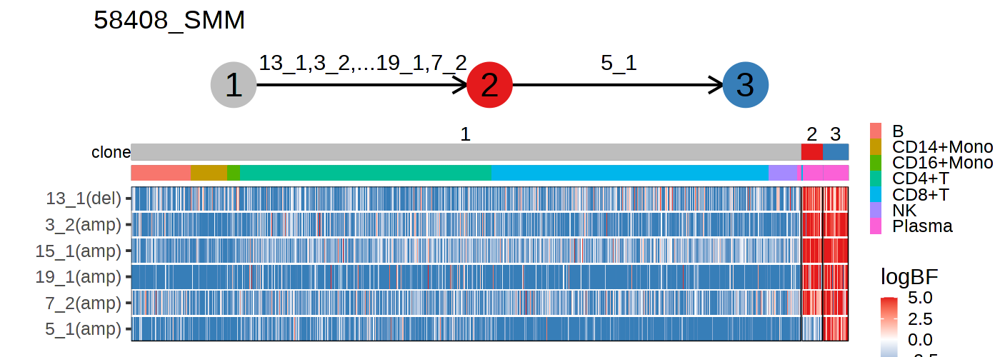

In [1449]:
options(repr.plot.width = 7, repr.plot.height = 2.5, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_clone_panel(
    res[[sample]],
    label = sample,
    cell_annot = cell_annot[[sample]] %>% mutate(annot = cell_type),
    ratio = 0.4
)

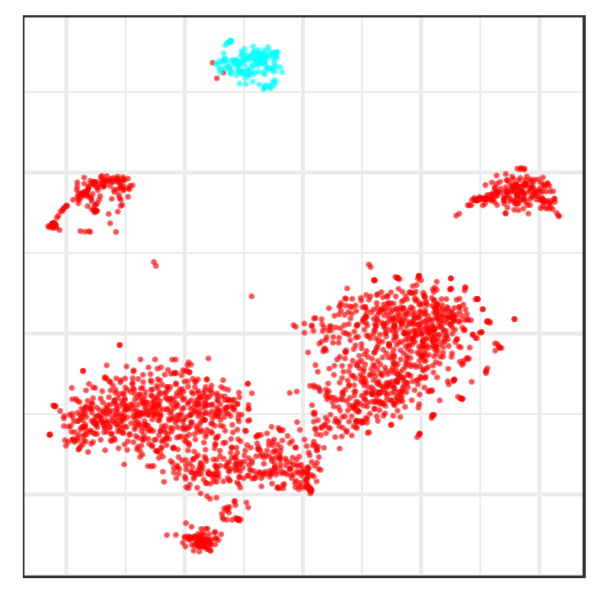

In [2645]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    groups = res[[sample]]$clone_post %>% 
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F,
    plot.theme = theme_bw()
)

## Primary

In [11]:
sample = '58408_Primary'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

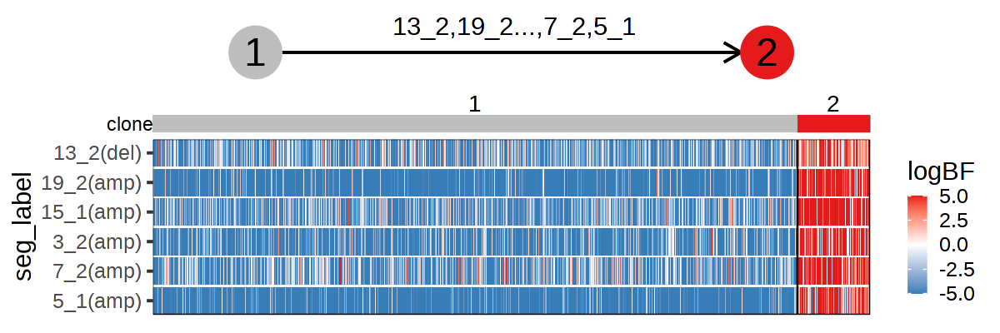

In [1278]:
options(repr.plot.width = 6, repr.plot.height = 2, repr.plot.res = 200)

plot_clone_panel(
    res[[sample]],
    ratio = 0.4
)

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.



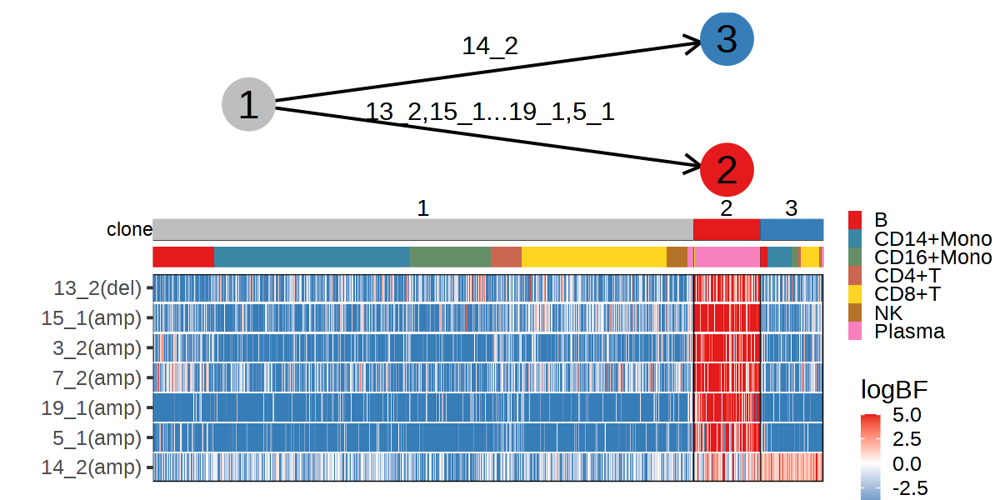

In [1669]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)

plot_clone_panel(
    res[[sample]],
    ratio = 0.7,
    cell_annot = cell_annot[[sample]] %>% mutate(annot = cell_type)
)

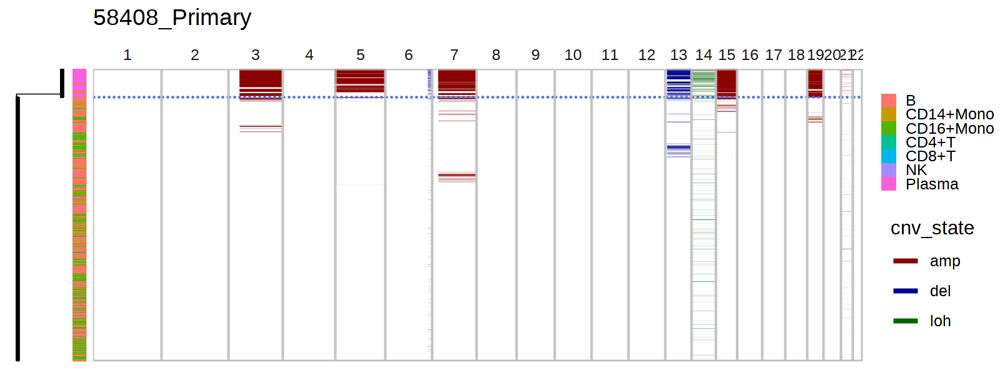

In [12]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.3,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 10
) +
ggtitle(sample)

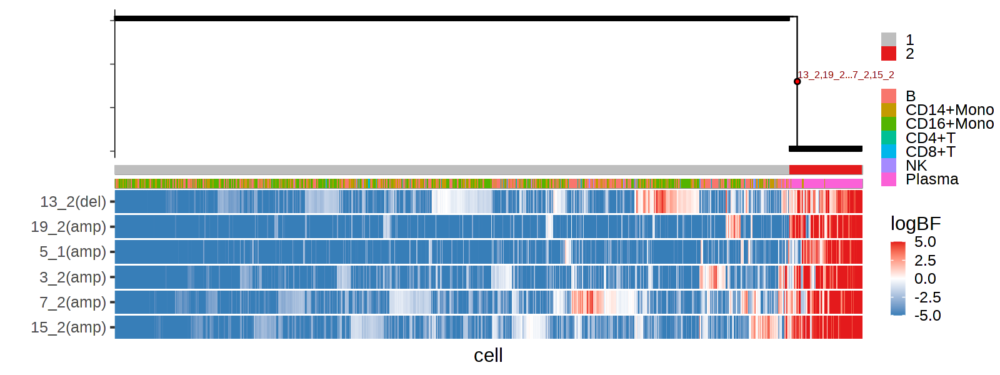

In [2648]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

tree_heatmap(
    res[[sample]]$joint_post %>% filter(seg %in% colnames(res[[sample]]$geno)),
    res[[sample]]$gtree,
    branch_width = 0.3,
    tip = F,
    tip_length = 0.1,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tvn = FALSE
) +
theme(plot.title = element_text(size = 8))

Warning message:
“Removed 163862 rows containing missing values (geom_point).”
Warning message:
“Removed 97481 rows containing missing values (geom_point).”


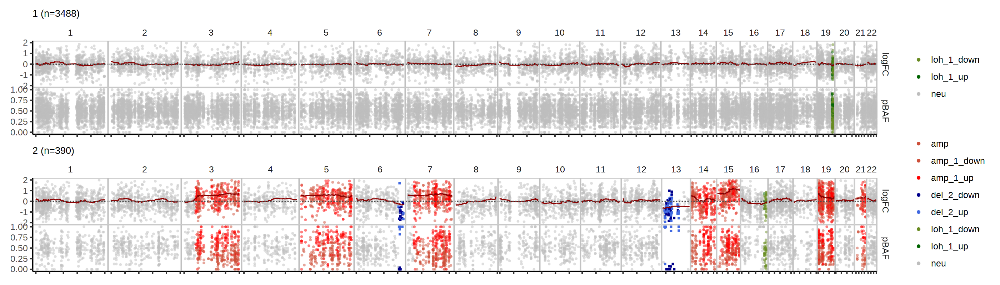

In [1250]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

res[[sample]]$bulk_clones %>% plot_bulks(use_pos = TRUE)

In [1925]:
sample = '58408_Primary'

In [1934]:
res[[sample]]$gtree = mark_tumor_lineage(res[[sample]]$gtree)

In [1947]:
gtree = res[[sample]]$gtree %>% activate(nodes) %>% mutate(GT = ifelse(GT == '' & !is.na(site), site, GT))

In [2059]:
R.utils::sourceDirectory('~/Numbat/R')

clone_post = cell_to_clone(gtree, res[[sample]]$exp_post, res[[sample]]$allele_post)

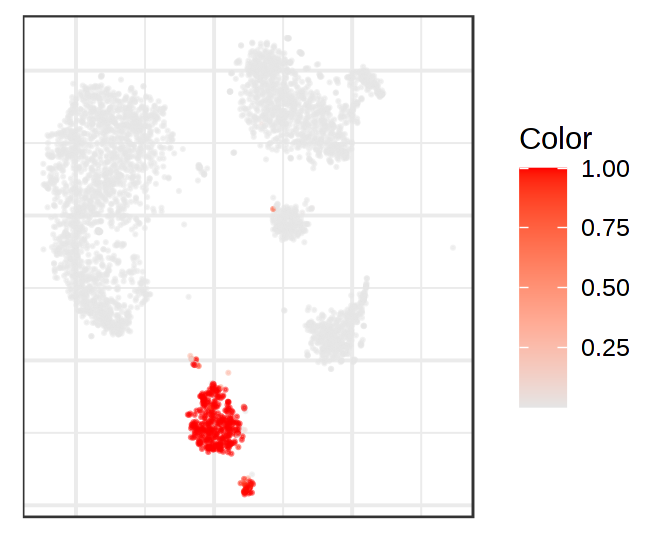

In [2649]:
options(repr.plot.width = 3.3, repr.plot.height = 2.7, repr.plot.res = 200)

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = clone_post %>% 
        {setNames(.$p_cnv_x, .$cell)},
    mark.groups = F,
    show.legend = T,
    plot.theme = theme_bw()
)
# guides(color = guide_colorbar(title = 'CNV prob')) +
# scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



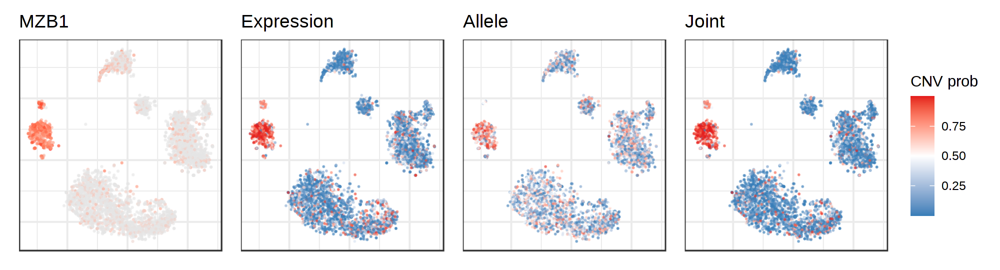

In [1261]:
options(repr.plot.width = 10, repr.plot.height = 2.7, repr.plot.res = 200)

cnv = '13_2'

p_annot = con$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.2,
    groups = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)}, 
    plot.theme = theme_bw(),
    plot.na = F,
    gene = 'MZB1',
    title = 'MZB1'
)

p_joint = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$joint_post %>% 
        filter(seg == cnv) %>%
        {setNames(.$p_cnv, .$cell)},
    mark.groups = F,
    title = 'Joint',
    show.legend = T,
    plot.theme = theme_bw()
) +
guides(color = guide_colorbar(title = 'CNV prob')) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)

p_exp = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$joint_post %>% 
        filter(seg == cnv) %>%
        {setNames(.$p_cnv_x, .$cell)},
    mark.groups = F,
    title = 'Expression',
    show.legend = F,
    plot.theme = theme_bw()
) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)

p_allele = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$joint_post %>% 
        filter(seg == cnv) %>%
        {setNames(.$p_cnv_y, .$cell)},
    title = 'Allele',
    show.legend = F,
    plot.theme = theme_bw()
) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, oob = scales::oob_squish)

p_annot | p_exp | p_allele | p_joint

# 47491

## SMM

In [13]:
sample = '47491_SMM'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

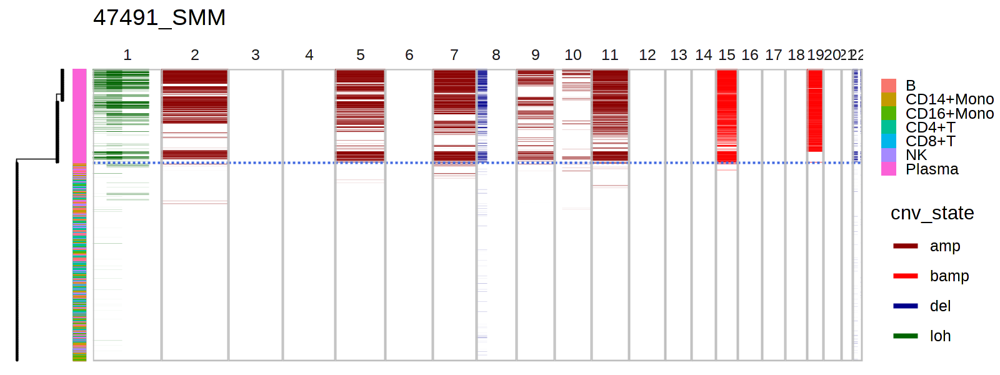

In [14]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.3,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 10
) +
ggtitle(sample)

## Primary

In [51]:
nb = c()

In [52]:
R.utils::sourceDirectory('~/Numbat/R')

sample = '47491_Primary'

out_dir = glue('~/paper_data/numbat_out/{sample}_test')
nb[[sample]] = Numbat$new(out_dir, i = 2)

Could not read the input file ~/paper_data/numbat_out/47491_Primary_test/bulk_clones_final.tsv.gz with data.table::fread(). Please check that the file is valid.



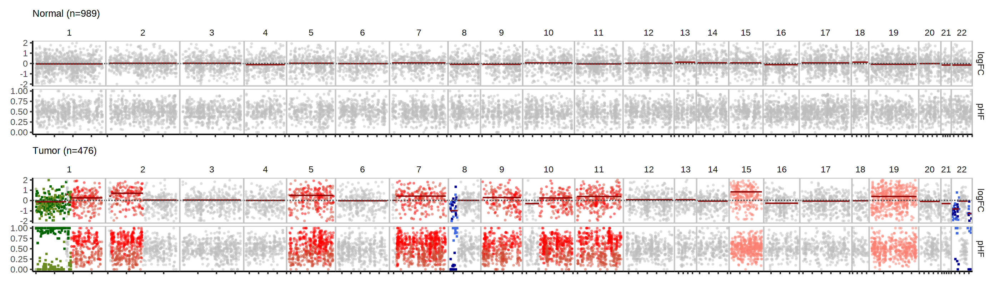

In [130]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

bind_rows(
    nb[[sample]]$bulk_subtrees %>% filter(sample == 2) %>% mutate(sample = 'Tumor'),
    nb[[sample]]$bulk_clones %>% filter(sample == 1) %>% mutate(sample = 'Normal')
) %>%
plot_bulks(use_pos = FALSE, phi_mle = TRUE)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



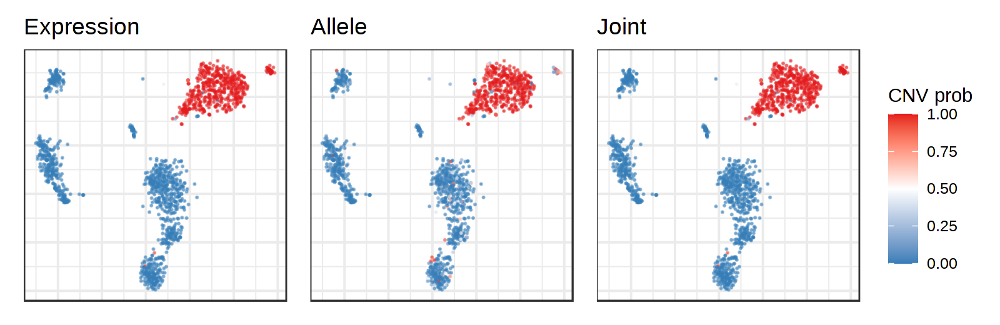

In [1400]:
options(repr.plot.width = 8, repr.plot.height = 2.6, repr.plot.res = 200)

p_joint = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        mutate(p = 1 - p_x_1) %>%
        mutate(p = pmax(p, 0)) %>%
        {setNames(.$p, .$cell)},
    mark.groups = F,
    title = 'Joint',
    show.legend = T,
    plot.theme = theme_bw()
) +
guides(color = guide_colorbar(title = 'CNV prob')) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1), oob = scales::oob_squish)

p_exp = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        mutate(p = 1 - (p_x_1)) %>%
        mutate(p = pmax(p, 0)) %>%
        {setNames(.$p, .$cell)},
    mark.groups = F,
    title = 'Expression',
    show.legend = F,
    plot.theme = theme_bw()
) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1), oob = scales::oob_squish)

p_allele = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        mutate(p = 1 - p_y_1) %>%
        mutate(p = pmax(p, 0)) %>%
        {setNames(.$p, .$cell)},
    title = 'Allele',
    show.legend = F,
    plot.theme = theme_bw()
) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1), oob = scales::oob_squish)

p_exp | p_allele | p_joint

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



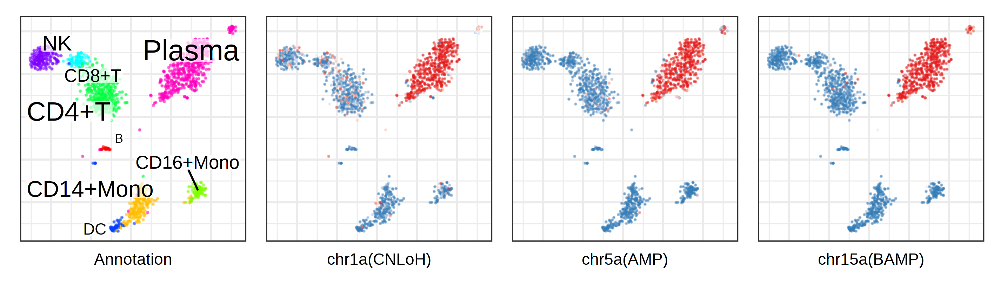

In [62]:
options(repr.plot.width = 9.5, repr.plot.height = 2.7, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

label_dict = c('bamp' = 'BAMP', 'amp' = 'AMP', 'loh' = 'CNLoH')

cnv = '1_1'
sample = '47491_Primary'

p_ct = con$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.2,
    groups = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)}, 
    plot.theme = theme_bw(),
    plot.na = F,
    raster = TRUE
) +
labs(caption = 'Annotation') +
theme(plot.caption = element_text(hjust = 0.5, size = 11)) 

p = lapply(
    c('1a', '5a', '15a'),
    function(cnv) {
        cnv_post = nb[[sample]]$joint_post %>% filter(seg == cnv) 
        con$samples[[sample]]$plotEmbedding(
            plot.na = F, 
            size = 0.1,
            alpha = 0.5,
            colors = cnv_post %>%
                {setNames(.$p_cnv, .$cell)},
            mark.groups = F,
            show.legend = F,
            plot.theme = theme_bw(),
            raster = TRUE
        ) +
        labs(caption = paste0('chr', cnv_post$seg, '(', label_dict[unique(cnv_post$cnv_state)], ')')) +
        theme(plot.caption = element_text(hjust = 0.5, size = 11)) +
        # guides(color = guide_colorbar(title = 'CNV prob')) +
        scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1), oob = scales::oob_squish)
    }
) %>%
c(list(p_ct), .) %>%
wrap_plots(nrow = 1) 

do_plot(p, '47491_tsne', 9.5, 2.7)

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.

Scale for 'colour' is already present. Adding another scale for 'colour',
which will replace the existing scale.



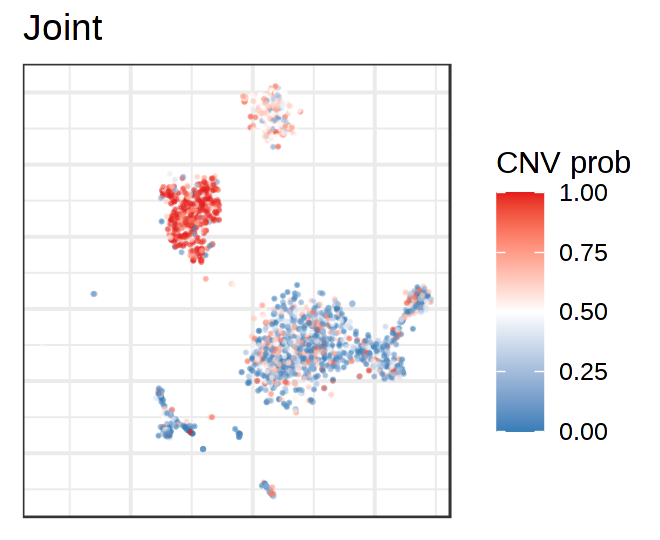

In [1329]:
options(repr.plot.width = 3.3, repr.plot.height = 2.7, repr.plot.res = 200)

cnv = '1_1'

p_joint = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$joint_post %>% 
        filter(seg == cnv) %>%
        {setNames(.$p_cnv, .$cell)},
    mark.groups = F,
    title = 'Joint',
    show.legend = T,
    plot.theme = theme_bw()
) +
guides(color = guide_colorbar(title = 'CNV prob')) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1), oob = scales::oob_squish)

p_exp = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$joint_post %>% 
        filter(seg == cnv) %>%
        {setNames(.$p_cnv_x, .$cell)},
    mark.groups = F,
    title = 'Expression',
    show.legend = F,
    plot.theme = theme_bw()
) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1),oob = scales::oob_squish)

p_allele = con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$joint_post %>% 
        filter(seg == cnv) %>%
        {setNames(.$p_cnv_y, .$cell)},
    title = 'Allele',
    show.legend = F,
    plot.theme = theme_bw()
) +
scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1), oob = scales::oob_squish)

p_joint

# 37692

In [185]:
bind_rows(cell_annot) %>% count(annot, cell_type)

annot,cell_type,n
<chr>,<chr>,<int>
N,B,3647
N,CD14+Mono,15992
N,CD16+Mono,4246
N,CD4+T,17609
N,CD8+T,7641
N,DC,735
N,NK,6281
N,Plasma,59
T,Plasma,16222


In [28]:
sample = '37692_Primary'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

In [2320]:
# options(repr.plot.width = 10, repr.plot.height = 3, repr.plot.res = 200)
# R.utils::sourceDirectory('~/Numbat/R')

# plot_clone_panel(
#     res[[sample]],
#     label = sample,
#     cell_annot = cell_annot[[sample]] %>% mutate(annot = cell_type),
#     ratio = 0.2
# )

Warning message:
“Removed 136438 rows containing missing values (geom_point).”
Warning message:
“Removed 51916 rows containing missing values (geom_point).”


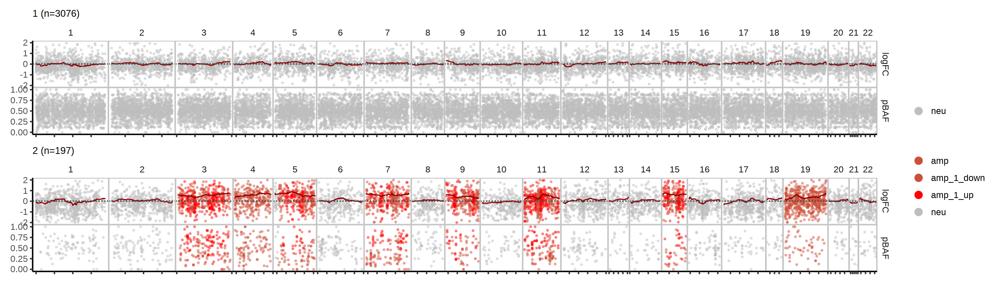

In [2580]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(res[[sample]]$bulk_subtrees, min_depth = 8)

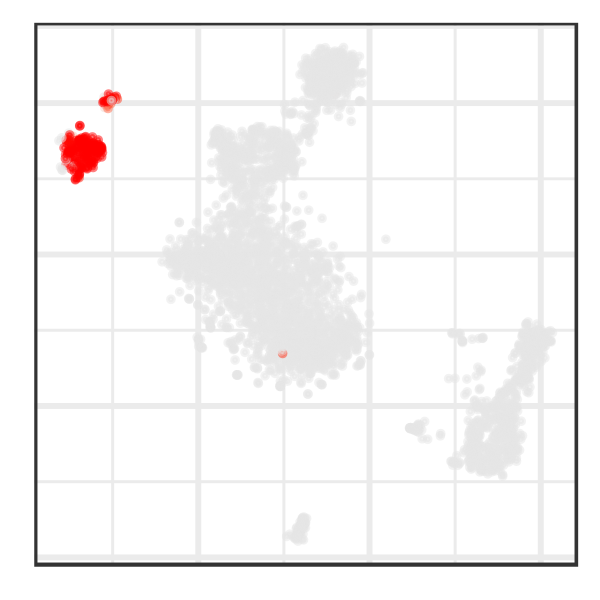

In [2575]:
options(repr.plot.width = 2, repr.plot.height = 2, repr.plot.res = 300)

pal = RColorBrewer::brewer.pal(n = 8, 'Set1')
colormap = leaflet::colorNumeric(c(pal[2], pal[1]), domain = c(0.95,1))

con$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.2, 
    plot.na = F,
    colors = res[[sample]]$clone_post %>%
        {setNames(.$p_cnv, .$cell)},
    show.legend = F,
    mark.groups = F
) 

In [2593]:
R.utils::sourceDirectory('~/Numbat/R')

D = plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 1,
    logBF_max = 5
)

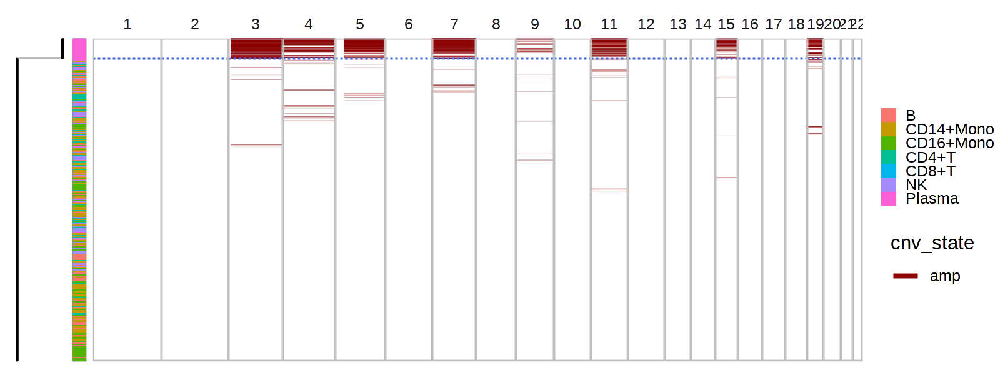

In [2625]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.1,
    logBF_min = 2,
    logBF_max = 10
)

# 77570

## HMM example

In [311]:
sample = '77570_Primary'

out_dir = glue('~/results/tvn/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

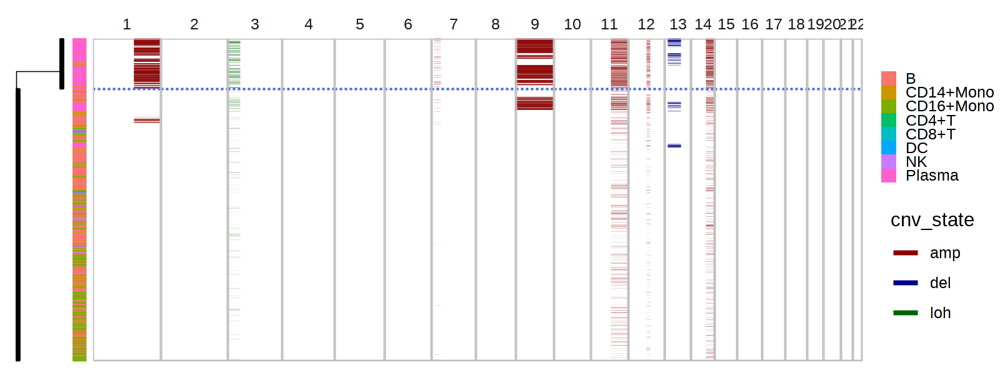

In [2438]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 2,
    logBF_max = 5
)

In [308]:
sample = '77570_Primary'

In [129]:
bulk_clones = fread('~/results/tvn/77570_Primary/bulk_clones_2.tsv.gz') %>% relevel_chrom()

In [126]:
load('~/numbat/data/acen.rda')

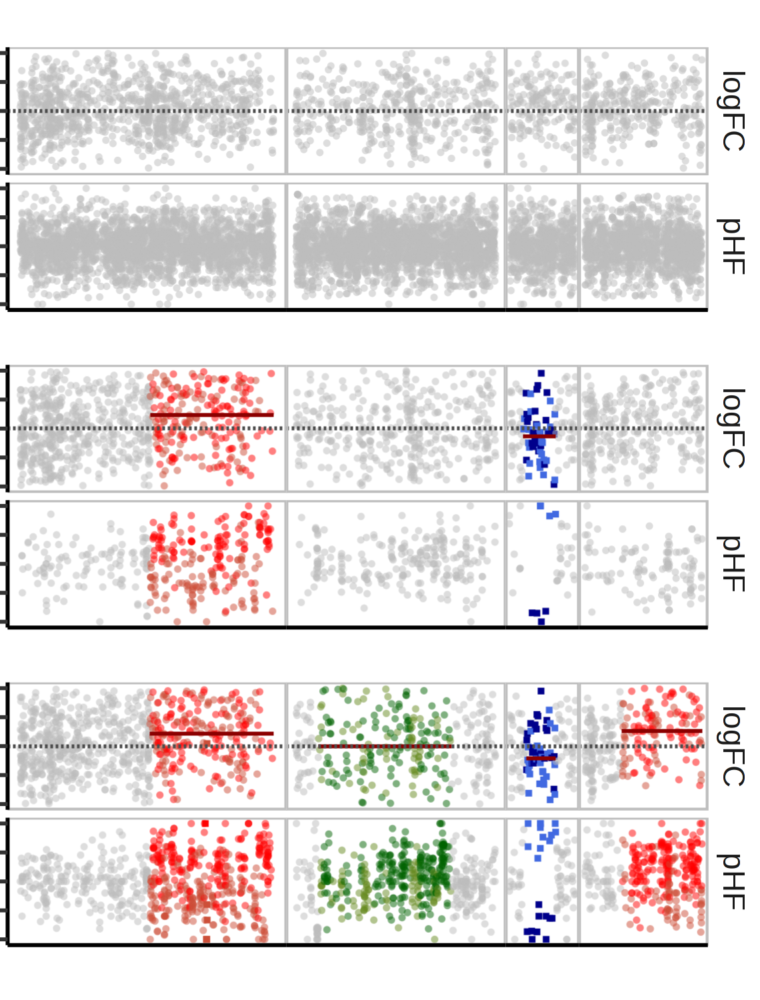

In [186]:
R.utils::sourceDirectory('~/Numbat/R')

p = bulk_clones %>%
    filter(CHROM %in% c(1, 7, 14, 13)) %>%
#     mutate(CHROM = paste0('chr', CHROM)) %>%
#     mutate(CHROM = factor(CHROM, unique(CHROM))) %>%
    plot_bulks(min_depth = 10, phi_mle = TRUE, use_pos = F, legend = F, title = F, raster = TRUE) &
    theme(
        plot.title = element_blank(),
        axis.text = element_blank(),
        strip.text.x = element_blank(),
        strip.text.y = element_text(size = 11),
        plot.margin = margin(3, 0, 3, 0, unit = 'mm')
    )

do_plot(p, 'hmm_example', 3.8, 5)

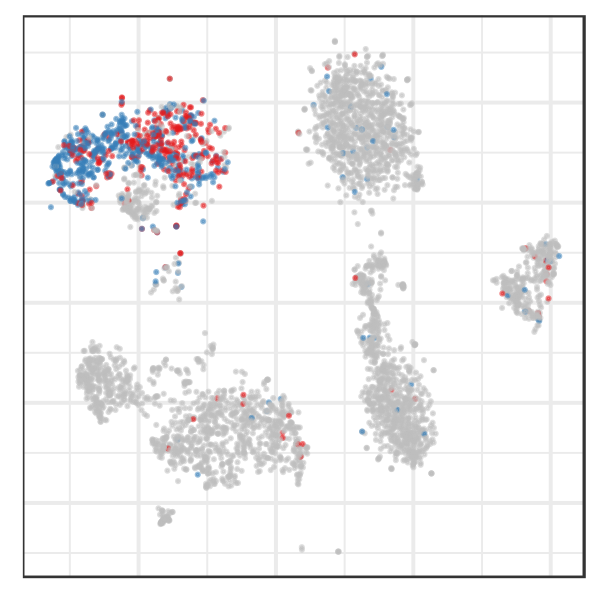

In [1468]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)
sample = '77570_Primary'

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    groups = res[[sample]]$clone_post %>% 
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F,
    palette = c('gray', pal),
    plot.theme = theme_bw()
)

# 83942

In [37]:
sample = '83942_Primary'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 1)

Warning message:
“Removed 190952 rows containing missing values (geom_point).”
Warning message:
“Removed 266523 rows containing missing values (geom_point).”


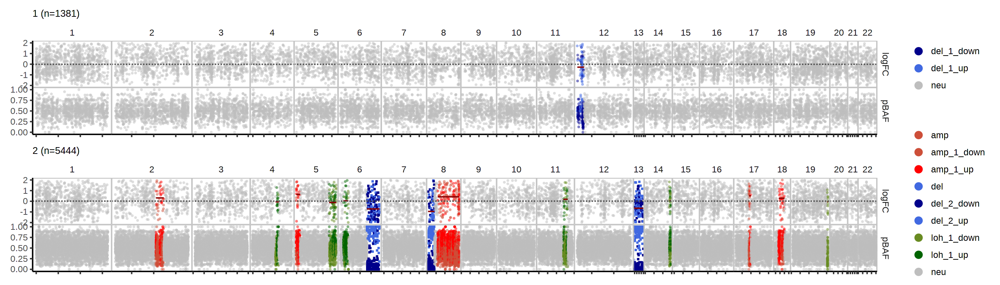

In [47]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(res[[sample]]$bulk_clones, min_depth = 8, phi_mle = TRUE)

In [54]:
res[[sample]]$segs_consensus %>% filter(cnv_state != 'neu') %>% arrange(-LLR)

sample,CHROM,seg,cnv_state,cnv_state_post,seg_start,seg_end,seg_start_index,seg_end_index,theta_mle,theta_sigma,phi_mle,phi_sigma,p_loh,p_del,p_amp,p_bamp,p_bdel,LLR,LLR_y,LLR_x,n_genes,n_snps,component,LLR_sample,seg_length,seg_cons
<dbl>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<int>,<dbl>,<int>,<chr>
0.2,6,6_4,del_2,del,87161101,170583760,69319,72143,0.39778138,0.002848716,0.6204872,0.04059576,7.855355e-09,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3808.16713,3781.56187,26.605257894,162,2496,3,3808.16713,83422659,6_4
0.2,13,13_1,del_2,del,18544453,114314503,124316,126493,0.38366030,0.003464131,0.6563448,0.04494792,8.220700e-06,9.999918e-01,0.000000e+00,0.000000e+00,0.000000e+00,2556.42920,2537.52656,18.902640454,147,1964,6,2556.42920,95770050,13_1
0.2,8,8_1,del_2,del,227044,31174361,81512,82903,0.34629713,0.004419162,0.5254578,0.05377174,7.920982e-10,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1637.94597,1618.17475,19.771218798,66,1302,4,1637.94597,30947317,8_1
0.2,8,8_3,amp_1,amp,58856398,145052467,83635,88577,0.13298267,0.002890737,1.3099781,0.07988748,2.261321e-02,4.260252e-09,9.773868e-01,1.322669e-122,5.765273e-131,887.78257,877.98091,9.801662675,186,4728,5,887.78257,86196069,8_3
0.2,5,5_1,amp_1,amp,204837,27081081,54078,54929,0.13416876,0.007309682,1.5641912,0.25949597,5.226949e-02,2.959588e-03,9.447709e-01,1.418641e-21,4.444033e-24,162.65394,159.01799,3.635949556,25,820,1,162.65394,26876244,5_1
0.2,4,4_2,del_1,loh,94660957,104970310,50301,50993,0.11089167,0.007793893,0.8810747,0.16765097,5.191766e-01,4.264749e-01,5.434849e-02,1.061225e-10,8.327476e-10,80.11593,79.89455,0.221385010,20,681,9,80.11593,10309353,4_2
0.2,19,19_2,del_1,loh,45995569,58584203,162879,165037,0.06656792,0.005304224,0.8656864,0.05544318,4.922508e-01,3.128911e-01,1.178766e-07,7.340952e-08,1.948580e-01,63.25199,60.71613,2.535864880,168,2017,14,63.25199,12588634,19_2
1.0,12,12_1,del_1,loh,266620,9711796,112117,113608,0.10679691,0.009224442,0.9056637,0.08096814,7.528345e-01,2.458912e-01,1.273568e-03,3.736408e-09,7.213985e-07,61.65950,61.04524,0.614265764,73,823,15,61.65950,9445176,12_2
0.2,18,18_2,amp_1,amp,13354106,49477503,154327,155648,0.07375282,0.006189204,1.2369648,0.15300657,2.629901e-01,5.386747e-03,6.736569e-01,5.750642e-02,4.598372e-04,59.27847,57.80060,1.477871249,46,1274,13,59.27847,36123397,18_2


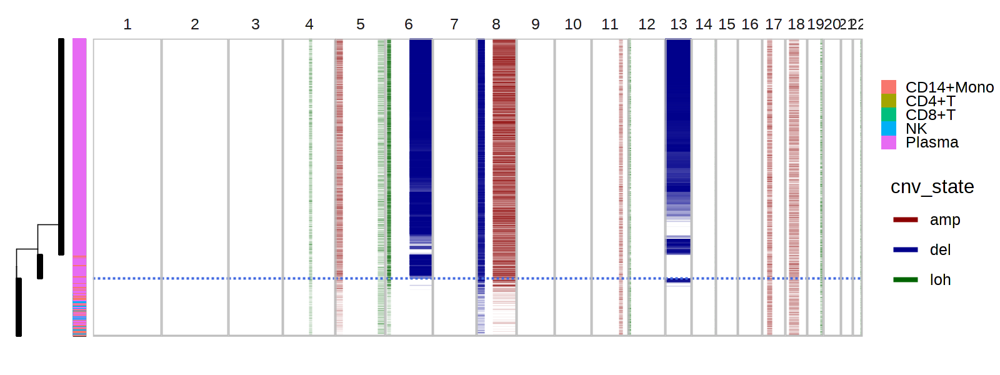

In [43]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$tree_post$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 0,
    logBF_max = 5
)

Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.



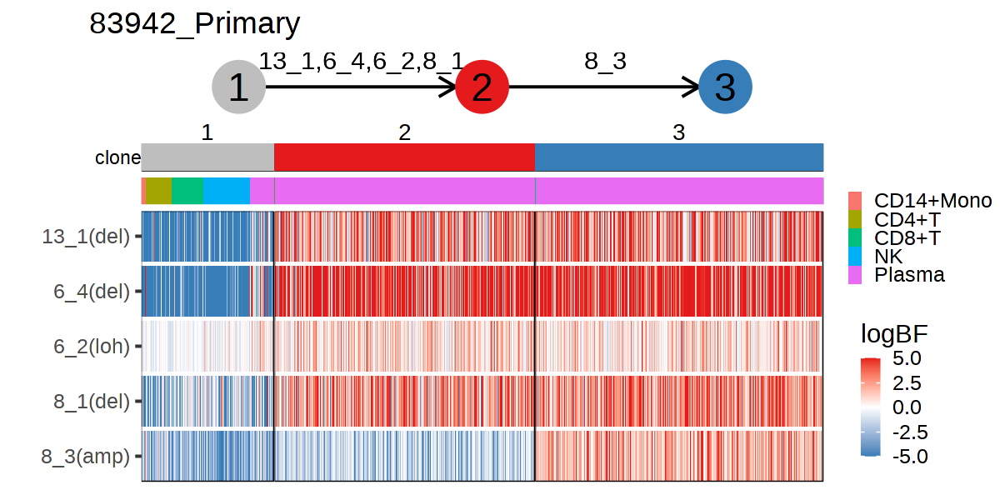

In [1481]:
options(repr.plot.width = 6, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_clone_panel(
    res[[sample]],
    label = sample,
    cell_annot = cell_annot[[sample]] %>% mutate(annot = cell_type),
    ratio = 0.2,
    p_min = 0.5
)

Warning message:
“Removed 189774 rows containing missing values (geom_point).”
Warning message:
“Removed 252364 rows containing missing values (geom_point).”
Warning message:
“Removed 255936 rows containing missing values (geom_point).”


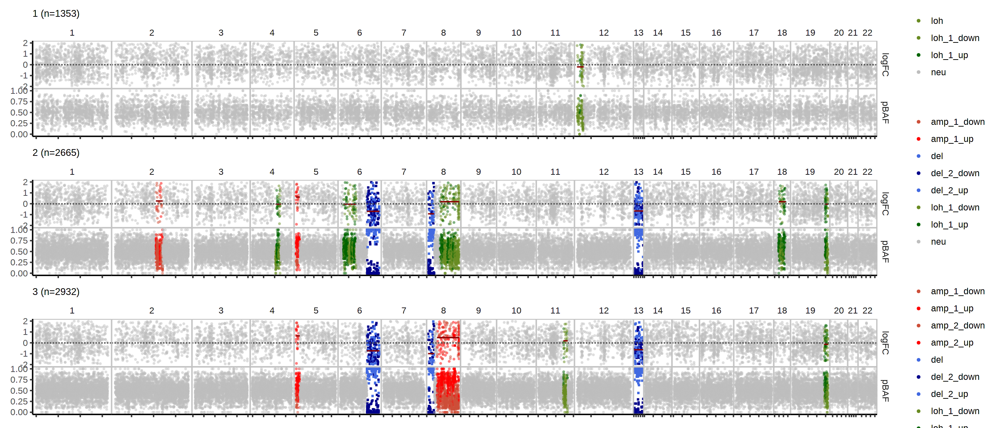

In [1463]:
options(repr.plot.width = 14, repr.plot.height = 6, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(res[[sample]]$bulk_clones, min_depth = 8, phi_mle = TRUE)

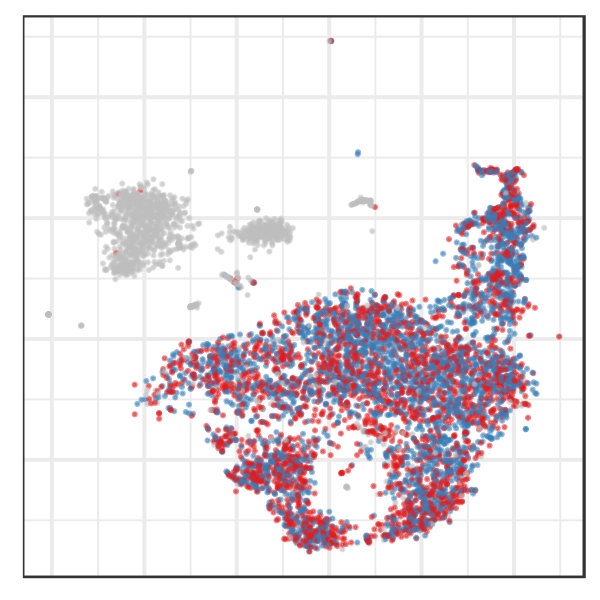

In [1470]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)
sample = '83942_Primary'

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    groups = res[[sample]]$clone_post %>% 
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F,
    palette = c('gray', pal),
    plot.theme = theme_bw()
)

# 60359

In [193]:
sample = '60359_Relapse_1'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

In [189]:
bulks = fread('/home/tenggao/results/WASHU/60359_Relapse_1/bulk_subtrees_0.tsv.gz')

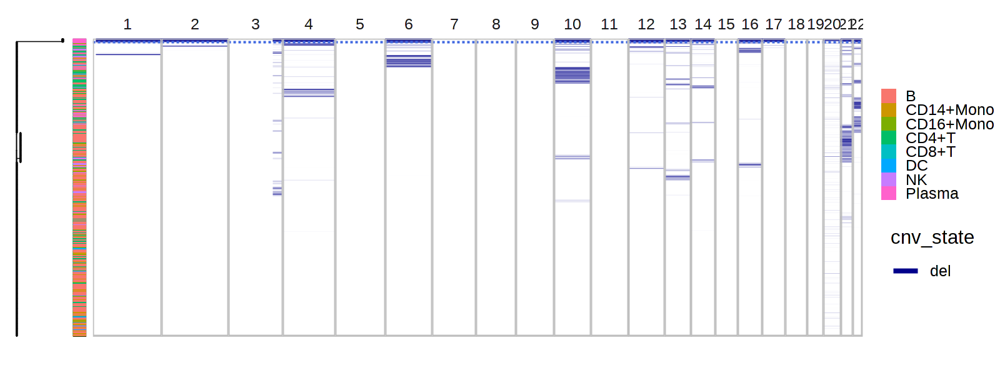

In [194]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 0,
    logBF_max = 5
)

Warning message:
“Removed 151682 rows containing missing values (geom_point).”
Warning message:
“Removed 21664 rows containing missing values (geom_point).”
Warning message:
“Removed 67147 rows containing missing values (geom_point).”


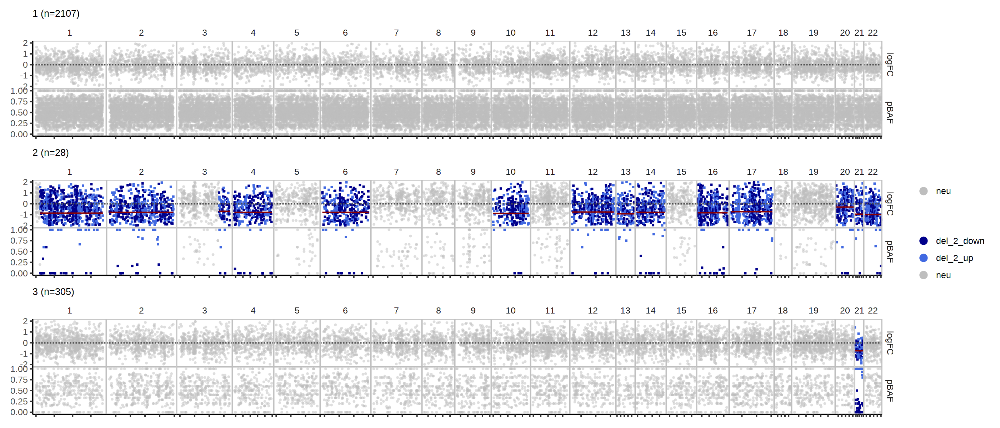

In [197]:
options(repr.plot.width = 14, repr.plot.height = 6, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(res[[sample]]$bulk_clones, min_depth = 5, phi_mle = TRUE)

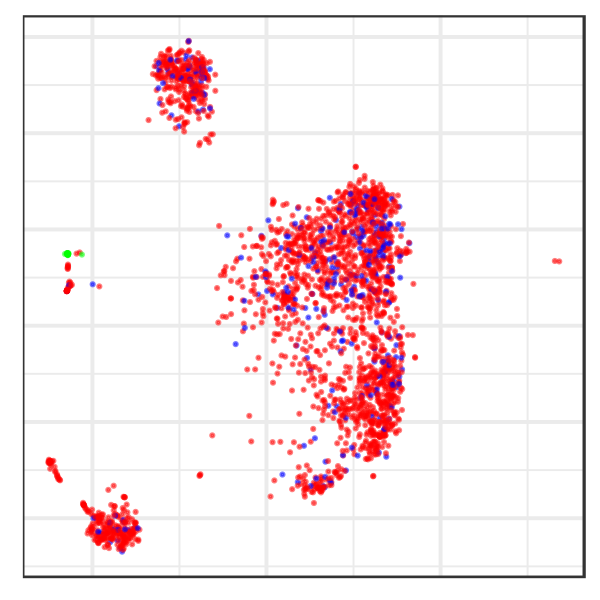

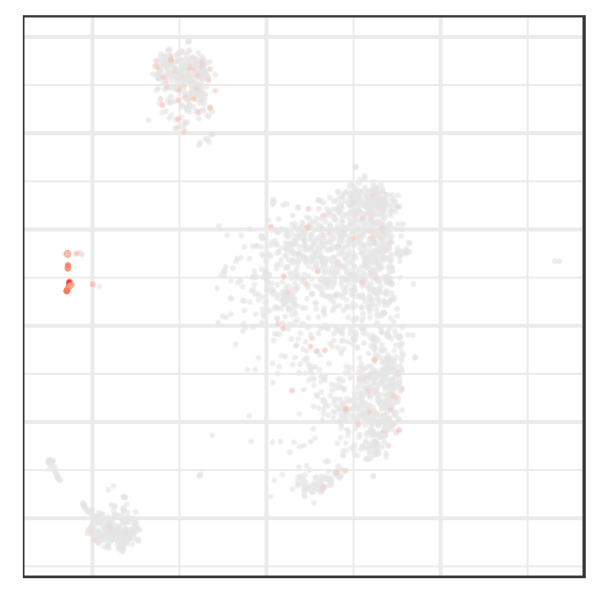

In [211]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    groups = res[[sample]]$clone_post %>% 
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F,
    show.legend = F,
    plot.theme = theme_bw()
)

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    groups = res[[sample]]$clone_post %>% 
        {setNames(.$clone_opt, .$cell)},
    mark.groups = F,
    show.legend = F,
    plot.theme = theme_bw(),
    gene = 'MZB1'
)

# guides(color = guide_colorbar(title = 'CNV prob')) +
# scale_color_gradient2(low = pal[2], high = pal[1], midpoint = 0.5, limits = c(0,1), oob = scales::oob_squish)

# 59114

In [327]:
sample = '59114_Relapse_1'

out_dir = glue('~/paper_data/results/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

Warning message:
“Removed 205013 rows containing missing values (geom_point).”
Warning message:
“Removed 113169 rows containing missing values (geom_point).”
Warning message:
“Removed 71867 rows containing missing values (geom_point).”


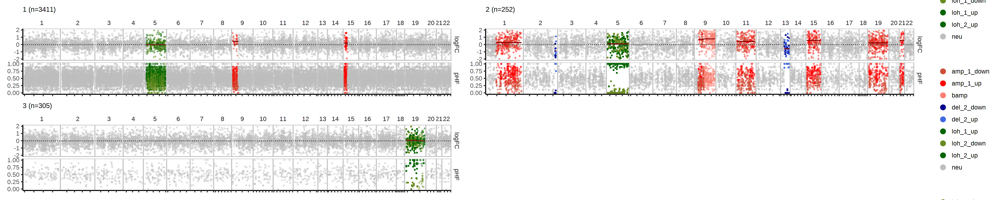

In [328]:
options(repr.plot.width = 20, repr.plot.height = 4, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')
sample = '59114_Relapse_1'
plot_bulks(res[[sample]]$bulk_subtrees, min_depth = 8, phi_mle = TRUE, ncol = 2)

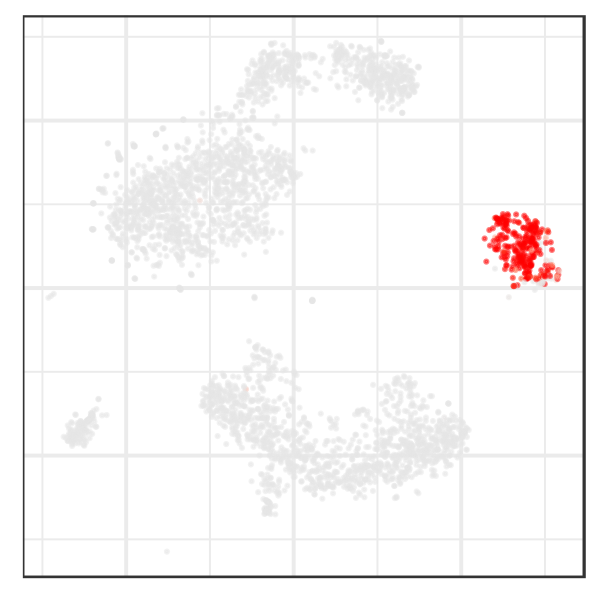

In [2445]:
options(repr.plot.width = 3, repr.plot.height = 3, repr.plot.res = 200)

con$samples[[sample]]$plotEmbedding(
    plot.na = F, 
    size = 0.1,
    alpha = 0.5,
    colors = res[[sample]]$clone_post %>% 
        {setNames(.$p_cnv, .$cell)},
    mark.groups = F,
#     palette = c('gray', pal),
    plot.theme = theme_bw()
)

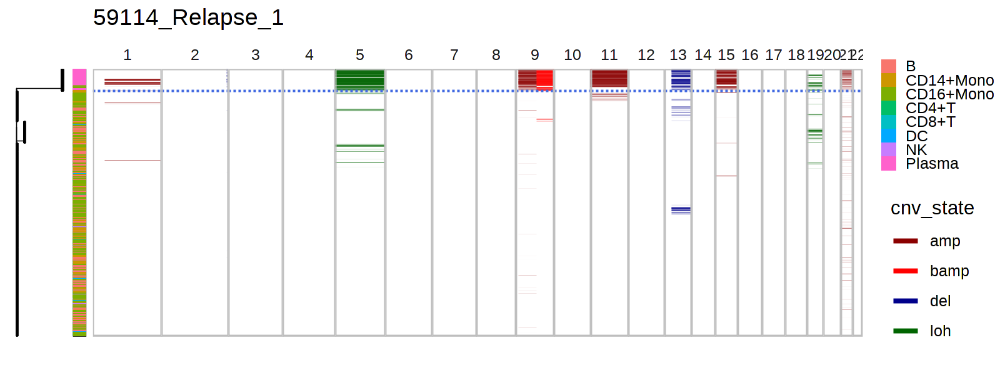

In [241]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 2,
    logBF_max = 5
) +
ggtitle(sample)

# 56203

In [24]:
sample = '56203_Primary'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

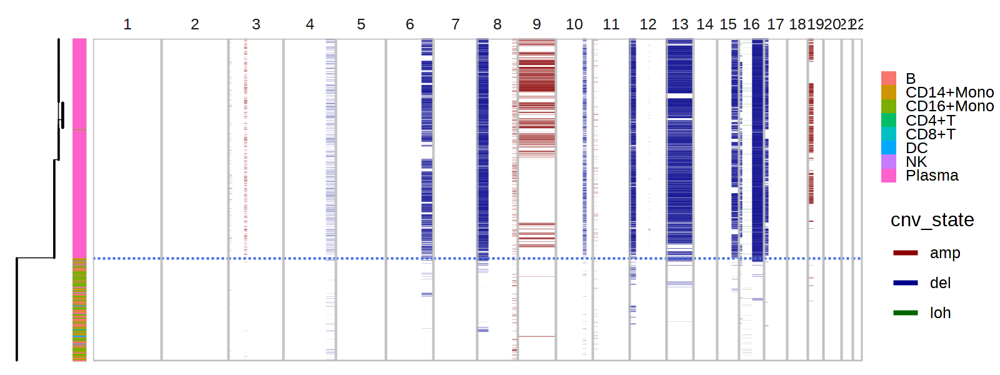

In [2464]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 2,
    logBF_max = 5
)

Warning message:
“Removed 153211 rows containing missing values (geom_point).”
Warning message:
“Removed 151904 rows containing missing values (geom_point).”
Warning message:
“Removed 143721 rows containing missing values (geom_point).”
Warning message:
“Removed 115249 rows containing missing values (geom_point).”


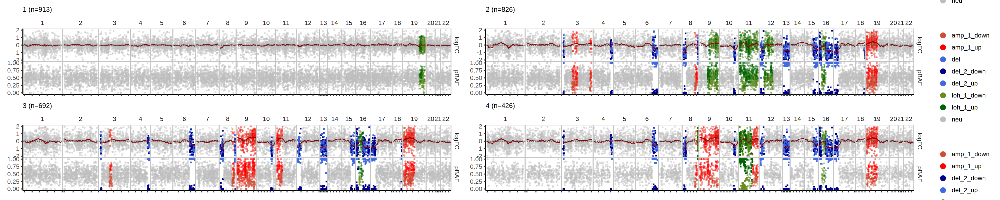

In [2475]:
options(repr.plot.width = 20, repr.plot.height = 4, repr.plot.res = 200)
sample = '56203_Primary'

plot_bulks(res[[sample]]$bulk_clones, min_depth = 8, ncol = 2)

In [25]:
sample = '56203_Relapse_1'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

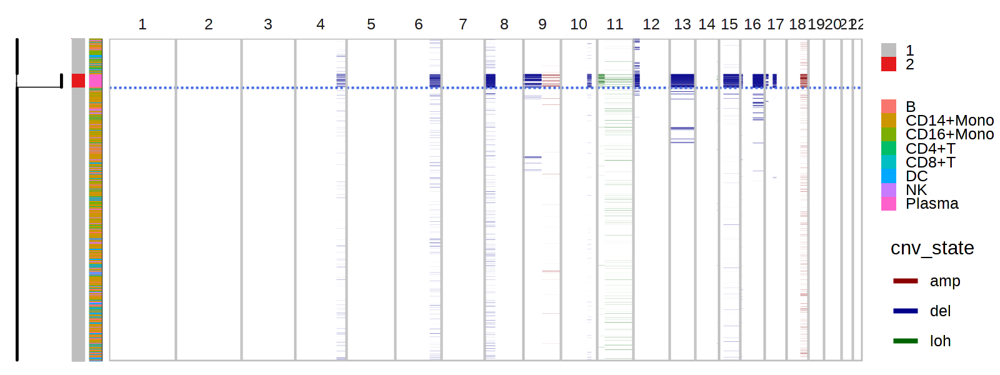

In [2469]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 2,
    logBF_max = 5,
    clone_bar = T
)

Warning message:
“Removed 212908 rows containing missing values (geom_point).”
Warning message:
“Removed 72611 rows containing missing values (geom_point).”


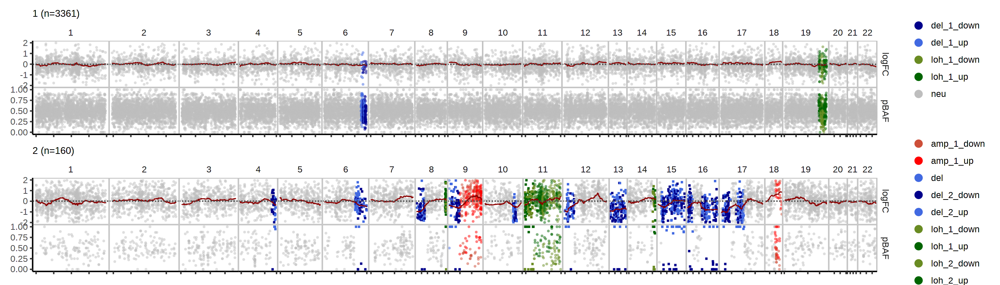

In [2472]:
options(repr.plot.width = 14, repr.plot.height = 4, repr.plot.res = 200)

plot_bulks(res[[sample]]$bulk_clones, min_depth = 8)

In [902]:
G_m = mut_tree_file %>% 
    read_mut_tree(tree_post$mut_nodes) %>%
    simplify_history(tree_post$l_matrix, max_cost = 150) %>%
    label_genotype()

mut_nodes = G_m %>% as_data_frame('vertices') %>% select(name = node, site = label)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)

opt_move:13_2->4_2,9_4, cost=0.597

opt_move:10_2->8_2, cost=0.808

opt_move:9_2->17_3, cost=0.844

opt_move:6_2->13_2,4_2,9_4, cost=1.21

opt_move:15_3->17_2, cost=1.68

opt_move:10_2,8_2->13_2,4_2,9_4,6_2, cost=2.96

opt_move:12_2->15_3,17_2, cost=3.1

opt_move:16_4->10_2,8_2,13_2,4_2,9_4,6_2, cost=8.67

opt_move:15_2->17_3,9_2, cost=10.6

opt_move:18_2->10_2,8_2,13_2,4_2,9_4,6_2,16_4, cost=17.6

opt_move:9_3->15_2,17_3,9_2, cost=35

opt_move:11_2->19_2, cost=52.1

opt_move:11_2,19_2->12_2,15_3,17_2, cost=54.8

opt_move:11_2,19_2,12_2,15_3,17_2->10_2,8_2,13_2,4_2,9_4,6_2,16_4,18_2, cost=112

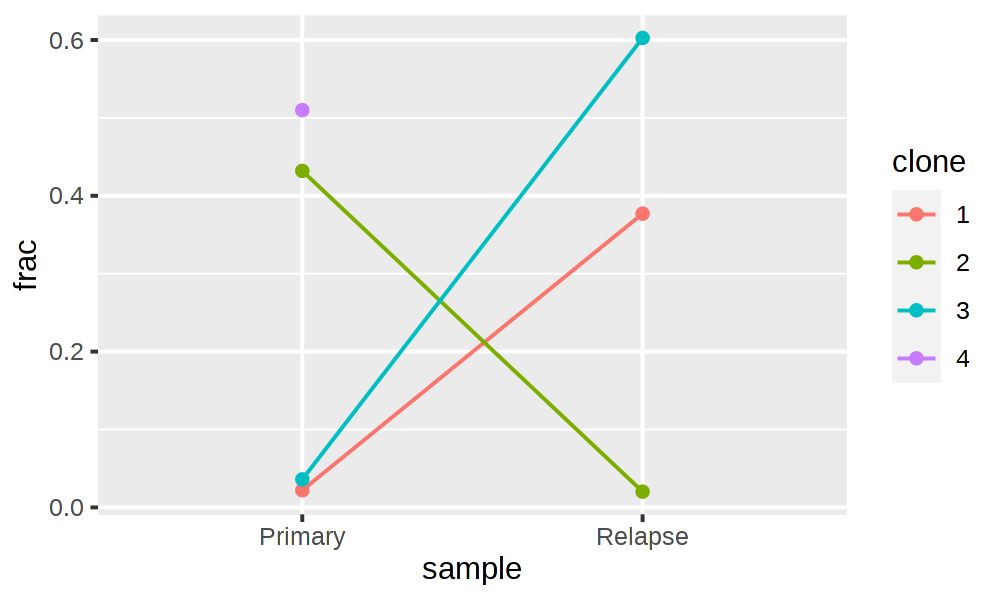

In [920]:
options(repr.plot.width = 5, repr.plot.height = 3, repr.plot.res = 200)

clone_post = cell_to_clone(gtree, exp_post, allele_post)

clone_post %>%
rename(clone = clone_opt) %>%
mutate(sample = str_extract(cell, 'Primary|Relapse')) %>%
count(sample, clone) %>%
group_by(sample) %>%
mutate(frac = n/sum(n)) %>%
mutate(clone = factor(clone)) %>%
ggplot(
    aes(x = sample, y = frac, group = clone, color = clone)
) +
geom_line() +
geom_point()

# 81012

In [1033]:
sample = '81012_Primary'

i = 1
out_dir = glue('~/results/tvn/{sample}')
joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
exp_post = fread(glue('{out_dir}/exp_post_{i}.tsv'))
allele_post = fread(glue('{out_dir}/allele_post_{i}.tsv'))
bulk0 = fread(glue('{out_dir}/bulk_subtrees_0.tsv'))

In [ ]:
G_m = mut_tree_file %>% 
    read_mut_tree(tree_post$mut_nodes) %>%
    simplify_history(tree_post$l_matrix, max_cost = 150) %>%
    label_genotype()

mut_nodes = G_m %>% as_data_frame('vertices') %>% select(name = node, site = label)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)

Warning message:
“Removed 169685 rows containing missing values (geom_point).”
Warning message:
“Removed 158356 rows containing missing values (geom_point).”
Warning message:
“Removed 145617 rows containing missing values (geom_point).”
Warning message:
“Removed 88365 rows containing missing values (geom_point).”
Warning message:
“Removed 111513 rows containing missing values (geom_point).”


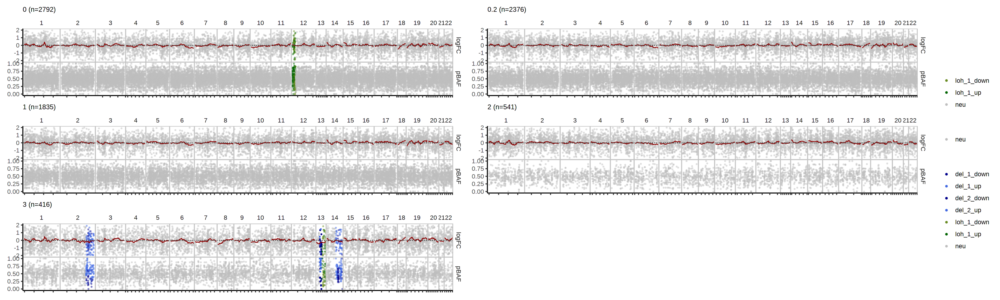

In [1035]:
options(repr.plot.width = 20, repr.plot.height = 6, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_bulks(bulk0, ncol = 2)

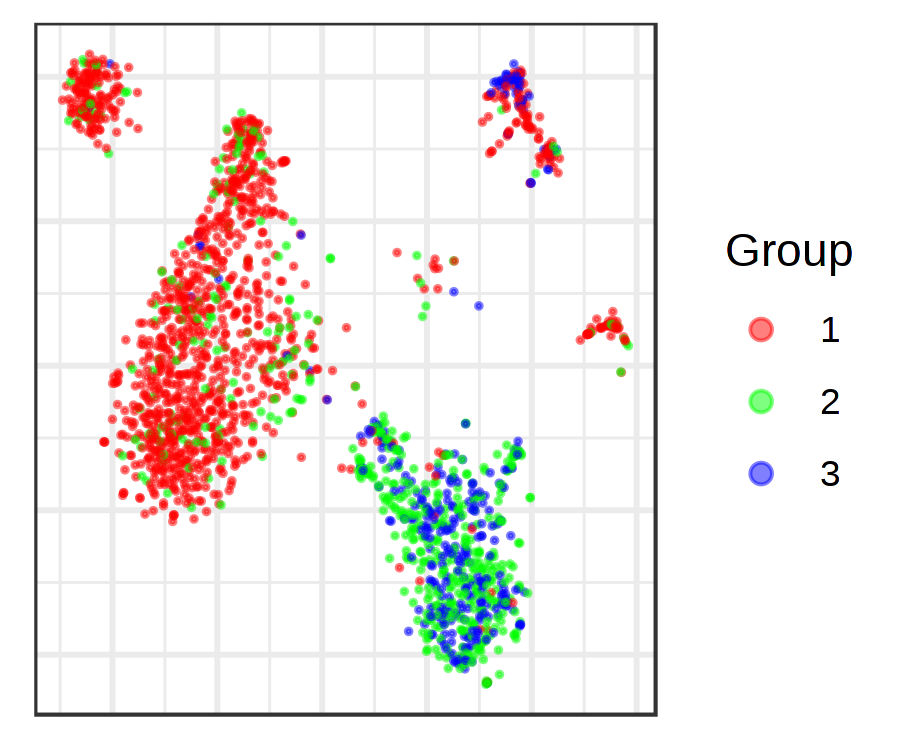

In [800]:
options(repr.plot.width = 3, repr.plot.height = 2.5, repr.plot.res = 300)

con$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.2, 
    groups = clone_post %>% {setNames(.$clone , .$cell)},
    show.legend = TRUE,
    mark.groups = F,
    plot.na = F,
    use.common.embedding = TRUE,
    title.size = 3
) +
guides(colour = guide_legend(override.aes = list(size = 2)))

Warning message:
“Removed 126641 rows containing missing values (geom_point).”
Warning message:
“Removed 117144 rows containing missing values (geom_point).”
Warning message:
“Removed 97715 rows containing missing values (geom_point).”


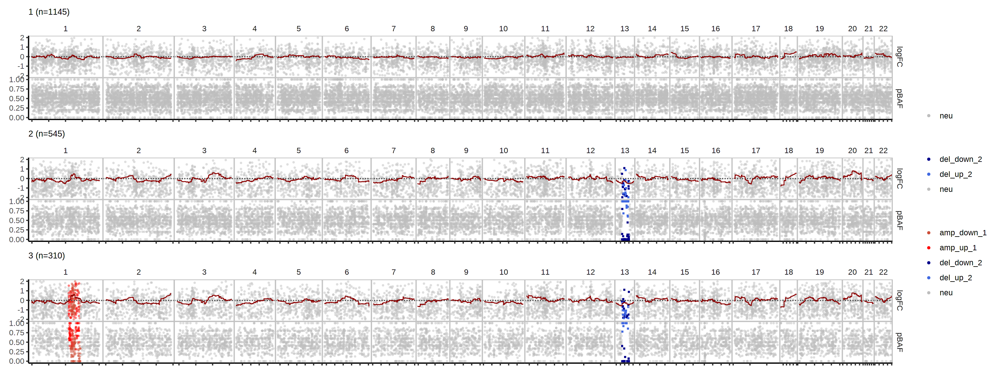

In [790]:
options(repr.plot.width = 16, repr.plot.height = 6, repr.plot.res = 200)

plot_bulks(bulk_clones, min_depth = 5)

## Replase

In [499]:
sample = '81012_Relapse_1'

i = 2
out_dir = glue('~/results/{sample}')
joint_post = fread(glue('{out_dir}/joint_post_{i}.tsv'))
exp_post = fread(glue('{out_dir}/exp_post_{i}.tsv'))
allele_post = fread(glue('{out_dir}/allele_post_{i}.tsv'))
bulk0 = fread(glue('{out_dir}/bulk_subtrees_0.tsv'))
geno = fread(glue('{out_dir}/geno_{i}.tsv')) %>% tibble::column_to_rownames('V1')
out_file = glue('{out_dir}/out_{i}.txt')
mut_tree_file = glue('{out_dir}/mut_tree_{i}.gml')
tree_post = readRDS(glue('{out_dir}/tree_post_{i}.rds'))
scistree_out = readRDS(glue('{out_dir}/scistree_out_{i}.rds'))
subtrees = readRDS(glue('{out_dir}/subtrees_{i}.rds'))
clones = readRDS(glue('{out_dir}/clones_{i}.rds'))
bulk_clones = fread(glue('{out_dir}/bulk_clones_{i}.tsv'))
bulk_subtrees = fread(glue('{out_dir}/bulk_subtrees_{i}.tsv'))

In [500]:
G_m = mut_tree_file %>% 
    read_mut_tree(tree_post$mut_nodes) %>%
    simplify_history(tree_post$l_matrix, max_cost = 150) %>%
    label_genotype()

mut_nodes = G_m %>% as_data_frame('vertices') %>% select(name = node, site = label)

# update tree
gtree = mut_to_tree(tree_post$gtree, mut_nodes)

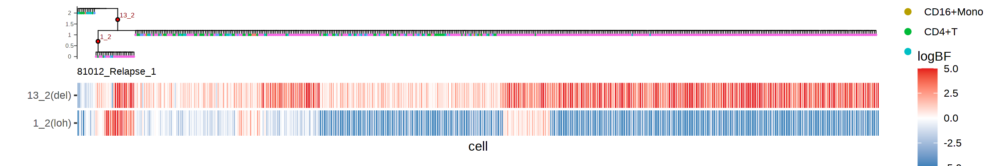

In [321]:
options(repr.plot.width = 12, repr.plot.height = 2, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

tree_heatmap2(
    joint_post %>% filter(seg %in% rownames(geno)),
    gtree,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)}
) +
ggtitle(sample) +
theme(plot.title = element_text(size = 8))

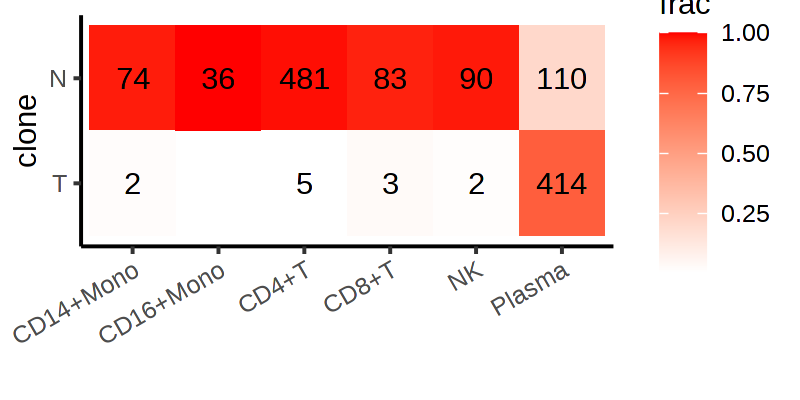

In [511]:
options(repr.plot.width = 4, repr.plot.height = 2, repr.plot.res = 200)

clone_post = cell_to_clone(gtree, exp_post, allele_post) 

clone_vs_annot(
    clone_post %>% 
        filter(cell %in% copykat.out$cell) %>%
        mutate(clone_opt = ifelse(p1 < 0.05, 'T', 'N')),
    cell_annot[[sample]]
)

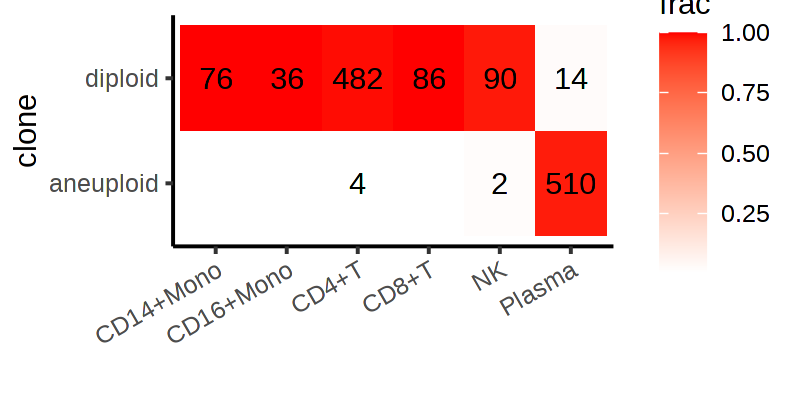

In [512]:
options(repr.plot.width = 4, repr.plot.height = 2, repr.plot.res = 200)

copykat.out = fread(glue('~/copykat_results/{sample}/{sample}_copykat_prediction.txt')) %>%
    rename(clone_opt = copykat.pred, cell = cell.names)

clone_vs_annot(
    copykat.out,
    cell_annot[[sample]]
)

In [466]:
# display_png(file = glue('~/copykat_results/{sample}/{sample}_copykat_heatmap.jpeg'), width = 800, height = 400)

Warning message:
“Removed 119301 rows containing missing values (geom_point).”
Warning message:
“Removed 125043 rows containing missing values (geom_point).”
Warning message:
“Removed 49153 rows containing missing values (geom_point).”


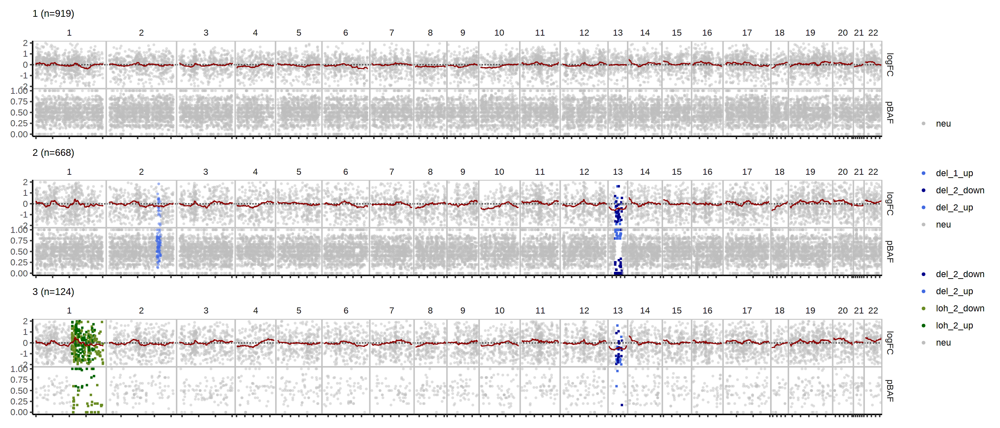

In [328]:
options(repr.plot.width = 14, repr.plot.height = 6, repr.plot.res = 200)

plot_bulks(bulk_clones, min_depth = 5)

Joining, by = "cell"

Warning message:
“Ignoring unknown parameters: title.size”


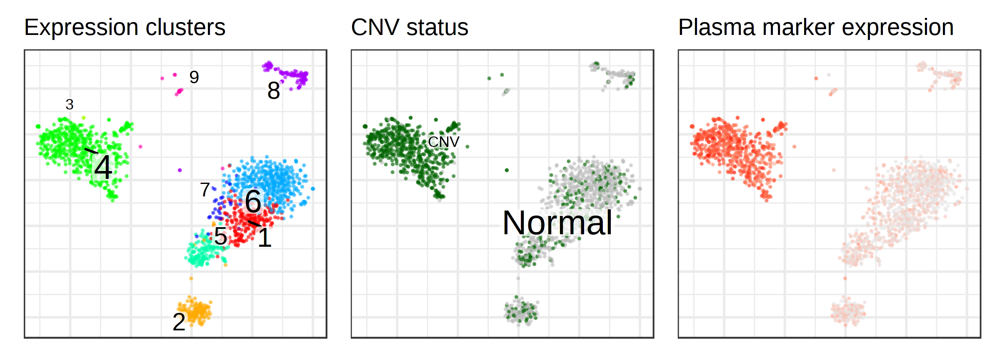

In [341]:
options(repr.plot.width = 8, repr.plot.height = 2.9, repr.plot.res = 300)

cell_clusters = con$samples[[sample]]$clusters$PCA$multilevel
cell_clusters = cell_clusters[names(cell_clusters) %in% joint_post$cell]

p1 = con$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.2, 
    groups = cell_clusters,
    plot.theme = theme_bw(),
    plot.na = F,
    title = 'Expression clusters'
)

p2 = con$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.2, 
    plot.na = F,
    groups = cell_clusters,
    plot.theme = theme_bw(),
    gene = 'MZB1',
    title = 'Plasma marker expression'
)

p3 = con$samples[[sample]]$plotEmbedding(
    alpha=0.5,
    size=0.2, 
    groups = cell_annot[[sample]] %>% 
        left_join(clone_post) %>%
        mutate(clone_opt = ifelse(clone_opt == 1, 'Normal', 'CNV')) %>%
        {setNames(.$clone_opt , .$cell)},
    show.legend = F,
    mark.groups = T,
    title.size = 3,
    plot.na = F,
    plot.theme = theme_bw(),
    title = 'CNV status',
    pal = c('darkgreen', 'gray')
)

p1 | p3 | p2

# 27522

## 27522_Primary

In [17]:
nb = list()

In [18]:
sample = '27522_Primary'

out_dir = glue('~/paper_data/numbat_out/{sample}_new')
nb[[sample]] = Numbat$new(out_dir, i = 2)

In [ ]:
pu = fread('~/external/WASHU/27522_Primary/WES/pu.txt')

Warning message:
“Using alpha for a discrete variable is not advised.”


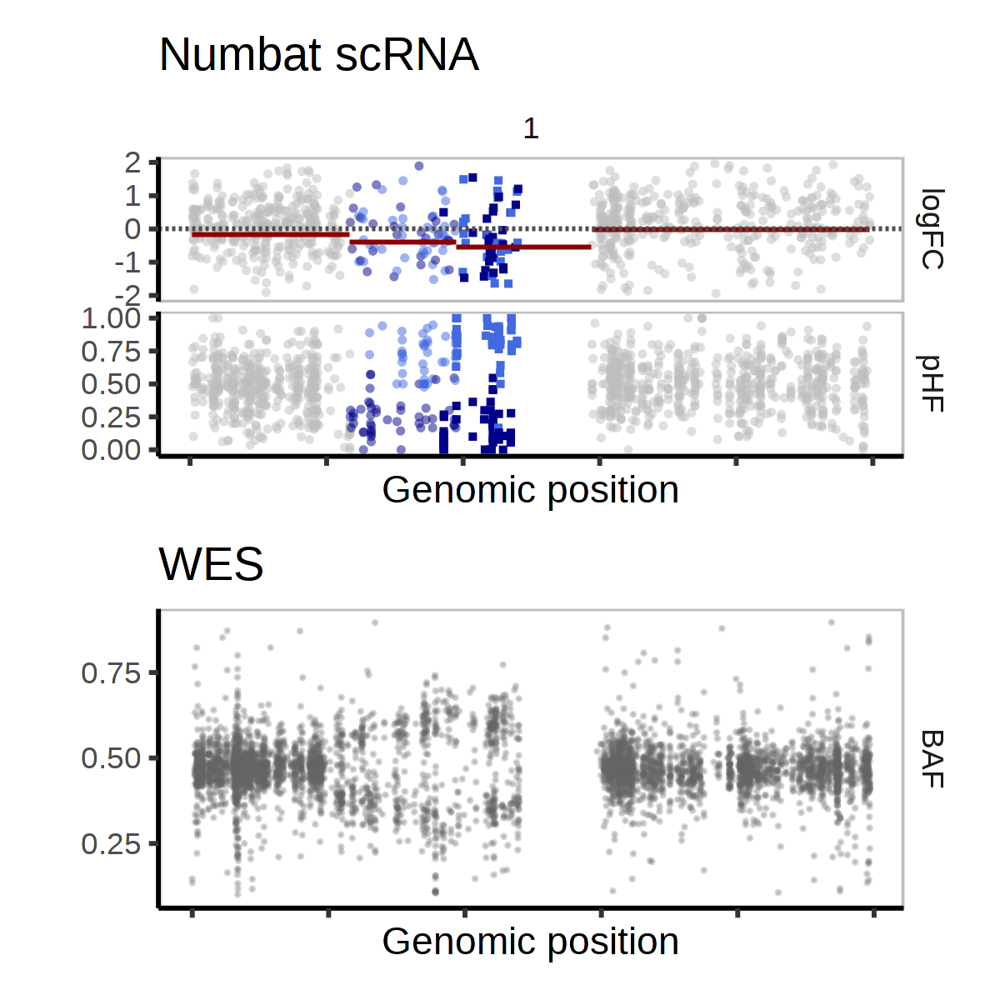

In [56]:
options(repr.plot.width = 4, repr.plot.height = 4, repr.plot.res = 300)
R.utils::sourceDirectory('~/Numbat/R')

p1 = nb[[sample]]$bulk_subtrees %>%
    filter(sample == 2) %>%
    filter(CHROM == 1) %>%
    plot_psbulk(use_pos = TRUE, min_depth = 10, legend = F) +
    ggtitle('Numbat scRNA')

p2 = pu %>% 
    filter(Chromosome == 'chr1') %>% 
    mutate(
        DP = File1R + File1A,
        BAF = File1A/DP
    ) %>%
    filter(DP > 30) %>%
    filter(BAF < 0.9 & BAF > 0.1) %>%
    mutate(group = 'BAF') %>%
    ggplot(
        aes(x = Position, y = BAF)
    ) +
    geom_point(size = 0.1, color = 'gray40', alpha = 0.25) +
    theme_classic() +
    theme(
        panel.spacing.x = unit(0, 'mm'),
        panel.spacing.y = unit(1, 'mm'),
        panel.border = element_rect(size = 0.5, color = 'gray', fill = NA),
        strip.background = element_blank(),
        axis.text.x = element_blank()
    ) +
    facet_grid(group~.) +
    xlab('Genomic position') +
    ggtitle('WES') +
    ylab('')

p1 / p2

In [799]:
joint_post_ori = fread(glue('~/results/{sample}/joint_post_2.tsv'))

In [810]:
exp_sc = fread(glue('{out_dir}/exp_sc_2.tsv.gz'))

Warning message:
“Removed 177762 rows containing missing values (geom_point).”
Warning message:
“Removed 154546 rows containing missing values (geom_point).”
Warning message:
“Removed 205831 rows containing missing values (geom_point).”


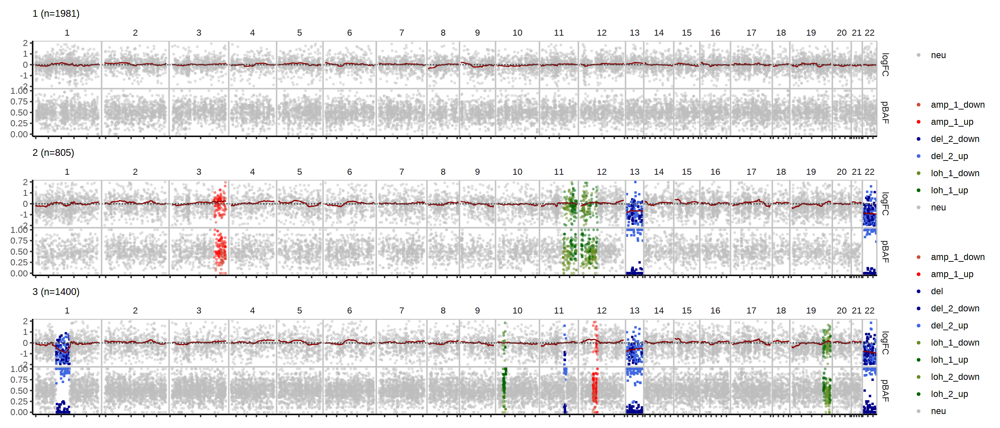

In [997]:
options(repr.plot.width = 14, repr.plot.height = 6, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

res[[sample]]$bulk_clones %>% plot_bulks()

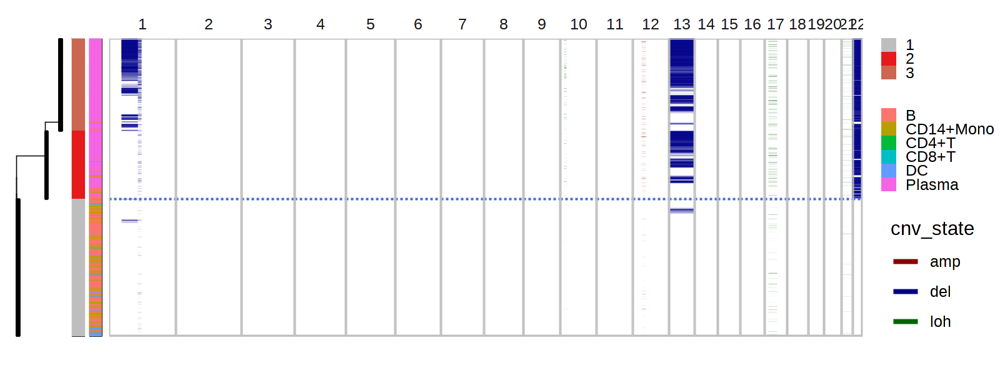

In [162]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 2,
    logBF_max = 5,
    clone_bar = T
)

In [452]:
# display_png(file = glue('~/copykat_results/{sample}/{sample}_copykat_heatmap.jpeg'), width = 800, height = 400)

## 27522_Relapse_2

In [169]:
sample = '27522_Relapse_2'

out_dir = glue('~/results/WASHU/{sample}')
res[[sample]] = fetch_results(out_dir, i = 2)

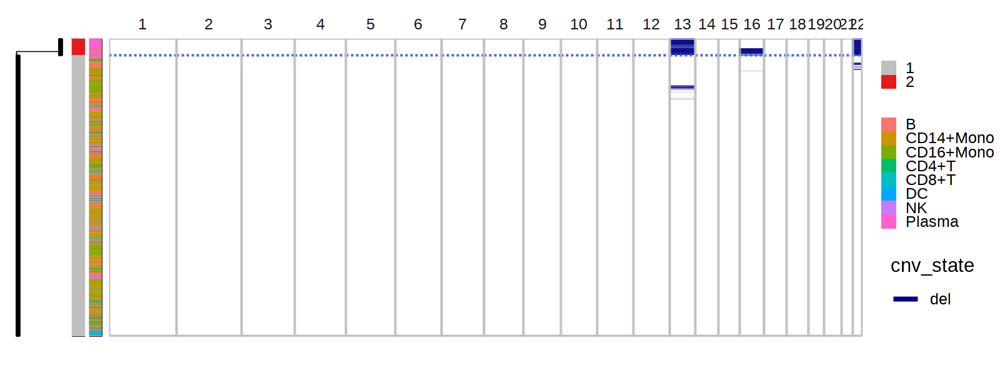

In [170]:
options(repr.plot.width = 8, repr.plot.height = 3, repr.plot.res = 200)
R.utils::sourceDirectory('~/Numbat/R')

plot_sc_joint(
    res[[sample]]$gtree,
    res[[sample]]$joint_post,
    res[[sample]]$segs_consensus,
    cell_dict = cell_annot[[sample]] %>% {setNames(.$cell_type, .$cell)},
    tip_length = 0.1,
    size = 0.05,
    logBF_min = 2,
    logBF_max = 5,
    clone_bar = T
)

In [445]:
clust = readRDS(glue('{out_dir}/clust.rds'))